In [1]:
import os
os.chdir('/data/l989o/deployed/a')
import sys
if '/data/l989o/a' in sys.path:
    sys.path.remove('/data/l989o/a')

In [2]:
from data import RawMeanDataset, RawMean12, NatureBImproved, NatureBOriginal, TransformedMeanDataset

class A:
    def __init__(self, model, model_id):
        self.model = model
        self.model_id = model_id
        self.instance = model + '_' + model_id
        if self.model_id == 'raw_mean_dataset':
            self.dataset = RawMeanDataset
        elif self.model_id == 'raw_mean12':
            self.dataset = RawMean12
        elif self.model_id == 'nature_b_improved':
            self.dataset = NatureBImproved
        elif self.model_id == 'nature_b_original':
            self.dataset = NatureBOriginal
        elif self.model_id == 'transformed_mean_dataset':
            self.dataset = TransformedMeanDataset
        else:
            raise ValueError(self.instance)
        self.ds_train = self.dataset('train')
        self.ds_validation = self.dataset('validation')

instances = [A('model_name', 'raw_mean_dataset'), A('vae', 'raw_mean12'), A('vae', 'nature_b_improved'), A('vae', 'nature_b_original'), A('vae', 'transformed_mean_dataset')]
import h5py
from data import file_path

  0%|          | 0/215 [00:00<?, ?it/s]/data/l989o/deployed/a/data.py:304: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  x0 = torch.tensor(x0, dtype=torch.float)
  5%|▌         | 11/215 [00:00<00:01, 106.66it/s]

True
<KeysViewHDF5 ['count', 'maximum', 'mean', 'sum', 'variance']>


100%|██████████| 119/119 [00:00<00:00, 163.90it/s]


In [3]:
def the_path(instance, f):
    root = file_path(instance.instance)
    assert os.path.isdir(root), root
    return os.path.join(root, f)

In [8]:
from models.train_vae import Vae
import ignite.distributed as idist
from h5_logger import H5Logger
import torch
from tqdm import tqdm

for instance in instances: 
    model = Vae(in_channels=39, hidden_layer_dimensions=5, out_channels=39)
    model = model.to(idist.device())
    model.load_state_dict(torch.load(the_path(instance, 'model.torch')))
    for split in ['train', 'validation']:
        path = the_path(instance, f'embedding_{split}.hdf5')
#         if os.path.isfile(path):
#             os.remove(path)
        if not os.path.isfile(path):
            EPOCH = 50
            print(f'embedding not found, creating it for EPOCH = {EPOCH}, path =', path)
            embedding_training_logger = H5Logger(path)
            embedding_training_logger.clear()
            if split == 'train':
                ds = instance.ds_train
            elif split == 'validation':
                ds = instance.ds_validation
            else:
                raise ValueError()

            # only_first_5_samples = False
            with torch.no_grad():
                list_of_reconstructed = []
                list_of_mu = []
                list_of_log_var = []
                iterator = tqdm(ds, desc='embedding', position=0, leave=True)
                for i, data in enumerate(iterator):
                    data.to(idist.device())
                    data = torch.unsqueeze(data, 0)
                    # data = [torch.unsqueeze(x, 0) for x in data]
                    recon_batch, mu, log_var = model.forward_step(data, model)
                    ome_filename = ds.filenames[i]

                    def u(x):
                        if len(x.shape) == 3 and x.shape[0] == 1:
                            x = x.reshape(-1, x.shape[2])
                        return x

                    f = lambda x: x.cpu().detach().numpy()
                    # reconstructed = ome_dataset.scale_back(reconstructed.cpu().detach(), i)
                    a = f(u(recon_batch))
                    b = f(u(mu))
                    c = f(u(log_var))
                    data = {f'{ome_filename}/reconstructed': a,
                            f'{ome_filename}/mu': b,
                            f'{ome_filename}/log_var': c}
                    embedding_training_logger.log(EPOCH, data)

embedding:   0%|          | 0/215 [00:00<?, ?it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/model_name_raw_mean_dataset/embedding_train.hdf5


embedding:   9%|▉         | 11/119 [00:00<00:00, 108.00it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/model_name_raw_mean_dataset/embedding_validation.hdf5


embedding:   4%|▍         | 9/215 [00:00<00:02, 88.05it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_raw_mean12/embedding_train.hdf5


embedding:  10%|█         | 12/119 [00:00<00:00, 118.98it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_raw_mean12/embedding_validation.hdf5


embedding:  21%|██▏       | 46/215 [00:00<00:00, 452.79it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_nature_b_improved/embedding_train.hdf5


embedding:  37%|███▋      | 44/119 [00:00<00:00, 439.87it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_nature_b_improved/embedding_validation.hdf5


embedding:  27%|██▋       | 58/215 [00:00<00:00, 577.73it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_nature_b_original/embedding_train.hdf5


embedding:  50%|█████     | 60/119 [00:00<00:00, 597.96it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_nature_b_original/embedding_validation.hdf5


embedding:   4%|▍         | 9/215 [00:00<00:02, 89.57it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset/embedding_train.hdf5


embedding:  10%|█         | 12/119 [00:00<00:00, 112.16it/s]

embedding not found, creating it for EPOCH = 50, path = /data/l989o/deployed/a/data/spatial_uzh_processed/a/vae_transformed_mean_dataset/embedding_validation.hdf5


embedding: 100%|██████████| 119/119 [00:01<00:00, 110.94it/s]


In [9]:
from scipy.stats import spearmanr
import numpy as np

all_k = set()
for instance in instances:
    f = the_path(instance, 'embedding_train.hdf5')
    with h5py.File(f, 'r') as f5:
        assert len(f5.keys()) == 1
        k, v = f5.items().__iter__().__next__()
        if len(all_k) == 0:
            bbb = True
        all_k.add(k)
        assert len(all_k) <= 1
        if bbb:
            print(f'EPOCH {k}')
            
        o_train = instance.ds_train.filenames        
        spearman_train_list = []
        for i, o in enumerate(tqdm(o_train, desc='spearamn train')):
            original = instance.ds_train[i].numpy()
            reconstructed = v[o]['reconstructed'][...]
            assert original.shape == reconstructed.shape
            correlations = []
            for c in range(39):
                x = original[:, c]
                y = reconstructed[:, c]
                r, p_value = spearmanr(x, y)
                correlations.append(r)
            corr = np.array(correlations).reshape((1, -1))
            spearman_train_list.append(corr)
        spearman_train = np.concatenate(spearman_train_list, axis=0)
        print(spearman_train.shape)
        instance.spearman_train = spearman_train
        
    f = the_path(instance, 'embedding_validation.hdf5')
    with h5py.File(f, 'r') as f5:
        assert len(f5.keys()) == 1
        k, v = f5.items().__iter__().__next__()
        if len(all_k) == 0:
            bbb = True
        all_k.add(k)
        assert len(all_k) <= 1
        if bbb:
            print(f'EPOCH {k}')
            
        o_validation = instance.ds_validation.filenames        
        spearman_validation_list = []
        for i, o in enumerate(tqdm(o_validation, desc='spearamn validation')):
            original = instance.ds_validation[i].numpy()
            reconstructed = v[o]['reconstructed'][...]
            assert original.shape == reconstructed.shape
            correlations = []
            for c in range(39):
                x = original[:, c]
                y = reconstructed[:, c]
                r, p_value = spearmanr(x, y)
                correlations.append(r)
            corr = np.array(correlations).reshape((1, -1))
            spearman_validation_list.append(corr)
        spearman_validation = np.concatenate(spearman_validation_list, axis=0)
        print(spearman_validation.shape)
        instance.spearman_validation = spearman_validation

spearamn train:   1%|▏         | 3/215 [00:00<00:09, 23.31it/s]

EPOCH epoch50


spearamn validation:   3%|▎         | 4/119 [00:00<00:03, 30.90it/s]

(215, 39)
EPOCH epoch50


spearamn train:   1%|▏         | 3/215 [00:00<00:08, 26.16it/s]

(119, 39)
EPOCH epoch50


spearamn validation:   3%|▎         | 3/119 [00:00<00:04, 28.06it/s]

(215, 39)
EPOCH epoch50


spearamn train:   2%|▏         | 4/215 [00:00<00:06, 34.18it/s]

(119, 39)
EPOCH epoch50


spearamn validation:   3%|▎         | 4/119 [00:00<00:03, 35.57it/s]

(215, 39)
EPOCH epoch50


spearamn train:   2%|▏         | 4/215 [00:00<00:05, 35.41it/s]

(119, 39)
EPOCH epoch50


spearamn validation:   3%|▎         | 4/119 [00:00<00:03, 31.71it/s]

(215, 39)
EPOCH epoch50


spearamn train:   1%|▏         | 3/215 [00:00<00:08, 24.88it/s]

(119, 39)
EPOCH epoch50


spearamn validation:   3%|▎         | 3/119 [00:00<00:04, 28.49it/s]

(215, 39)
EPOCH epoch50


spearamn validation: 100%|██████████| 119/119 [00:04<00:00, 27.61it/s]

(119, 39)


In [10]:
raw_train = RawMeanDataset('train')
counts = [(len(a), i) for i, a in enumerate(raw_train)]
counts = sorted(counts, key=lambda x: x[0])
train_sort = np.array([c[1] for c in counts])

raw_val = RawMeanDataset('validation')
counts = [(len(a), i) for i, a in enumerate(raw_val)]
counts = sorted(counts, key=lambda x: x[0])
val_sort = np.array([c[1] for c in counts])

(119, 39)


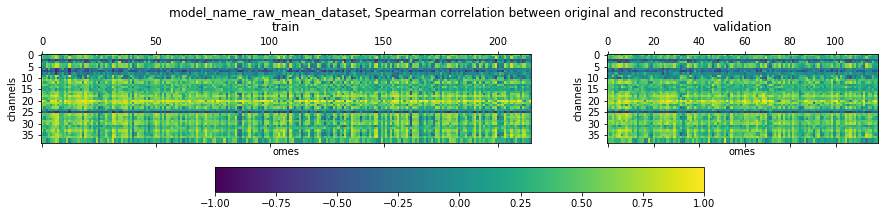

(119, 39)


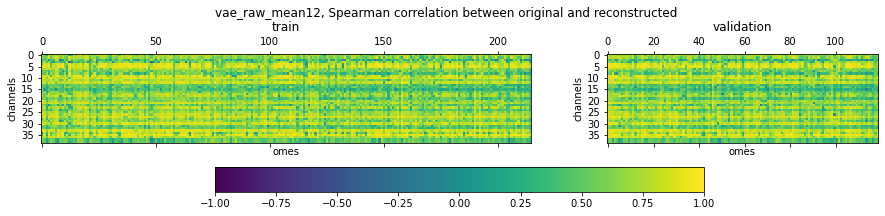

(119, 39)


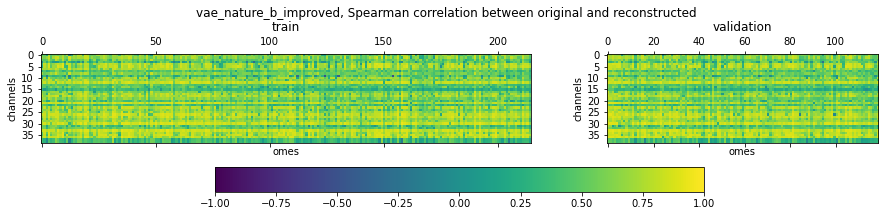

(119, 39)


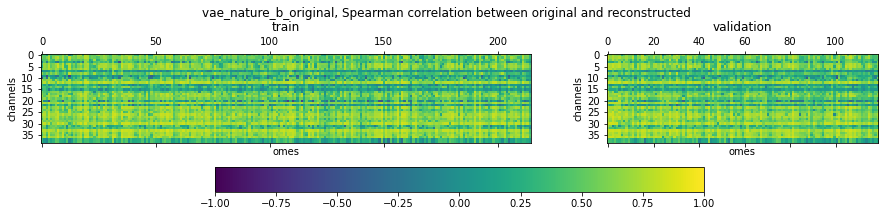

(119, 39)


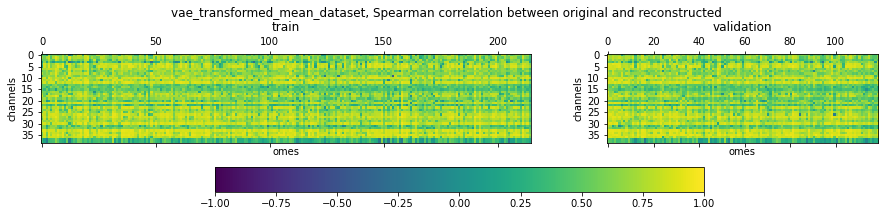

In [11]:
import matplotlib.pyplot as plt
import matplotlib

for instance in instances:
    print(instance.spearman_validation.shape)
    a = len(instance.spearman_train)
    b = len(instance.spearman_validation)
    
    fig = plt.figure(figsize=(15, 3)) # constrained_layout=True, 
#     fig.suptitle(instance.instance)
    gs = fig.add_gridspec(ncols=2, nrows=1, width_ratios=(a, b))
    ax0_0 = fig.add_subplot(gs[0, 0])
#     plt.subplot(1, 2, 1)
    plt.matshow(instance.spearman_train[train_sort, :].transpose(), interpolation='nearest', fignum=False)
    plt.clim(-1, 1)
    plt.title(f'train')
    plt.xlabel('omes')
    plt.ylabel('channels')

#     plt.subplot(1, 2, 2)
    ax0_1 = fig.add_subplot(gs[0, 1])
    pcm = plt.matshow(instance.spearman_validation[val_sort, :].transpose(), interpolation='nearest', fignum=False)
    plt.clim(-1, 1)
    plt.title(f'validation')
    plt.xlabel('omes')
    plt.ylabel('channels')
    
    fig.colorbar(pcm, ax=[ax0_0, ax0_1], location='bottom')
        
    plt.suptitle(f'{instance.instance}, Spearman correlation between original and reconstructed')
#     plt.tight_layout()
#     gs.tight_layout(fig)
#     gs.update(top=0.95)
#     x = 0.05
#     plt.subplots_adjust(left=x, bottom=x, right=1 - x, top=1 - x, wspace=None, hspace=0.2)
    plt.show()

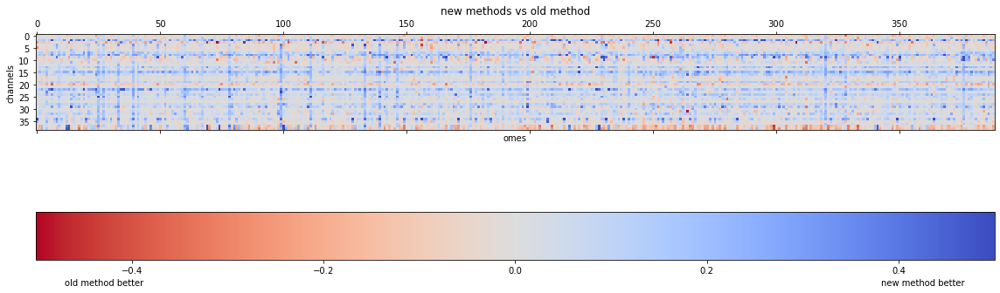

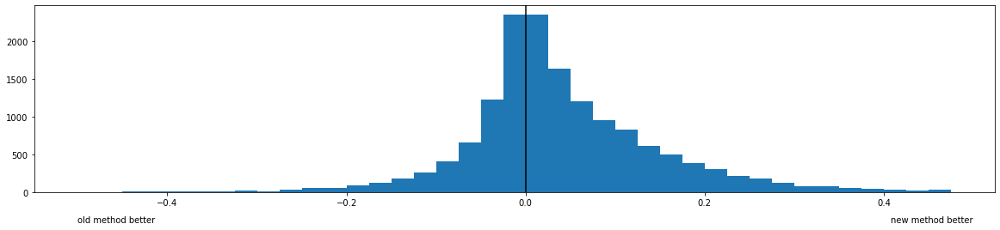

In [8]:
a12_instance, = [i for i in instances if i.instance == 'vae_raw_mean12']
transformed_instance, = [i for i in instances if i.instance == 'vae_transformed_mean_dataset']
nature_improved_instance, = [i for i in instances if i.instance == 'vae_nature_b_improved']
raw_instance, = [i for i in instances if i.instance == 'model_name_raw_mean_dataset']

m = transformed_instance.spearman_train[train_sort, :] - a12_instance.spearman_train[train_sort, :]
plt.figure(figsize=(16, 9))
plt.matshow(m.transpose(), fignum=False, cmap='coolwarm_r')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('old method better' + ' ' * 270 + 'new method better')
plt.xlabel('omes')
plt.ylabel('channels')
plt.title('new methods vs old method')
plt.clim(-0.5, 0.5)
plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 4))
plt.hist(m.flatten(), bins=np.arange(-0.5, 0.5, 0.025))
# plt.yscale('log')
plt.axvline(x=0, c='k')
plt.text(-0.5, -400, 'old method better', horizontalalignment='left')
plt.text(0.5, -400, 'new method better', horizontalalignment='right')
plt.show()

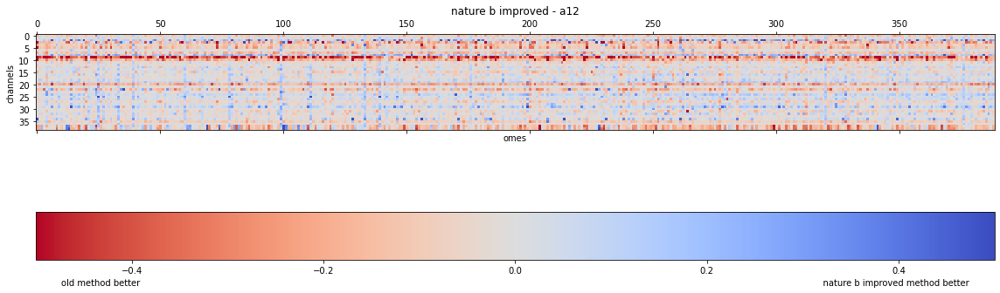

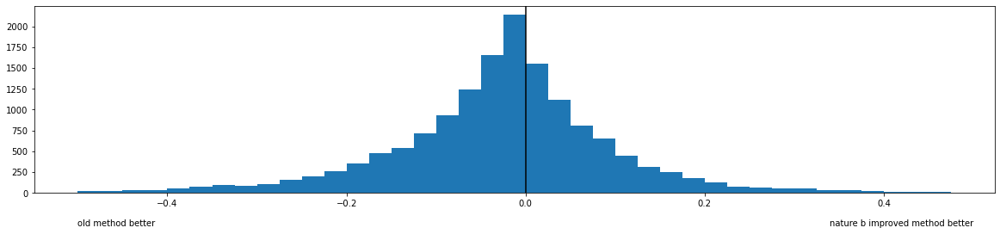

In [9]:
m = nature_improved_instance.spearman_train[train_sort, :] - a12_instance.spearman_train[train_sort, :]
plt.figure(figsize=(16, 9))
plt.matshow(m.transpose(), fignum=False, cmap='coolwarm_r')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('old method better' + ' ' * 250 + 'nature b improved method better')
plt.xlabel('omes')
plt.ylabel('channels')
plt.title('nature b improved - a12')
plt.clim(-0.5, 0.5)
plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 4))
plt.hist(m.flatten(), bins=np.arange(-0.5, 0.5, 0.025))
# plt.yscale('log')
plt.axvline(x=0, c='k')
plt.text(-0.5, -400, 'old method better', horizontalalignment='left')
plt.text(0.5, -400, 'nature b improved method better', horizontalalignment='right')
plt.show()

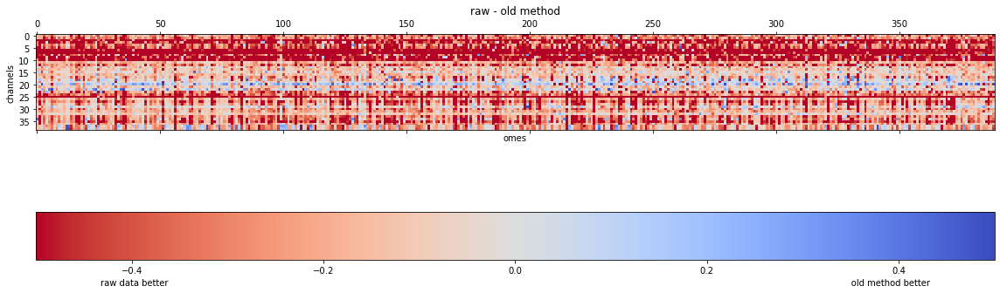

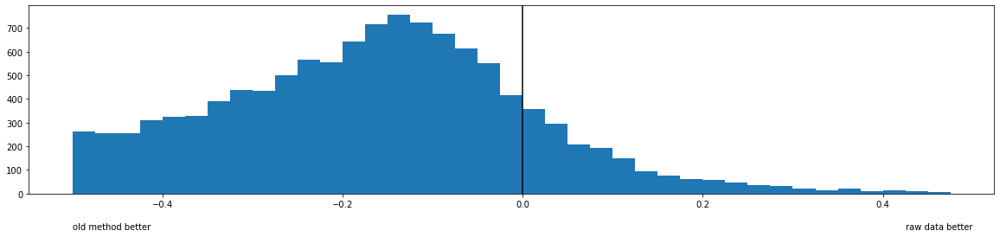

In [10]:
m = raw_instance.spearman_train[train_sort, :] - a12_instance.spearman_train[train_sort, :]
plt.figure(figsize=(16, 9))
plt.matshow(m.transpose(), fignum=False, cmap='coolwarm_r')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('raw data better' + ' ' * 250 + 'old method better')
plt.xlabel('omes')
plt.ylabel('channels')
plt.title('raw - old method')
plt.clim(-0.5, 0.5)
plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 4))
plt.hist(m.flatten(), bins=np.arange(-0.5, 0.5, 0.025))
# plt.yscale('log')
plt.axvline(x=0, c='k')
plt.text(-0.5, -150, 'old method better', horizontalalignment='left')
plt.text(0.5, -150, 'raw data better', horizontalalignment='right')
plt.show()

100%|██████████| 39/39 [00:00<00:00, 41.18it/s]


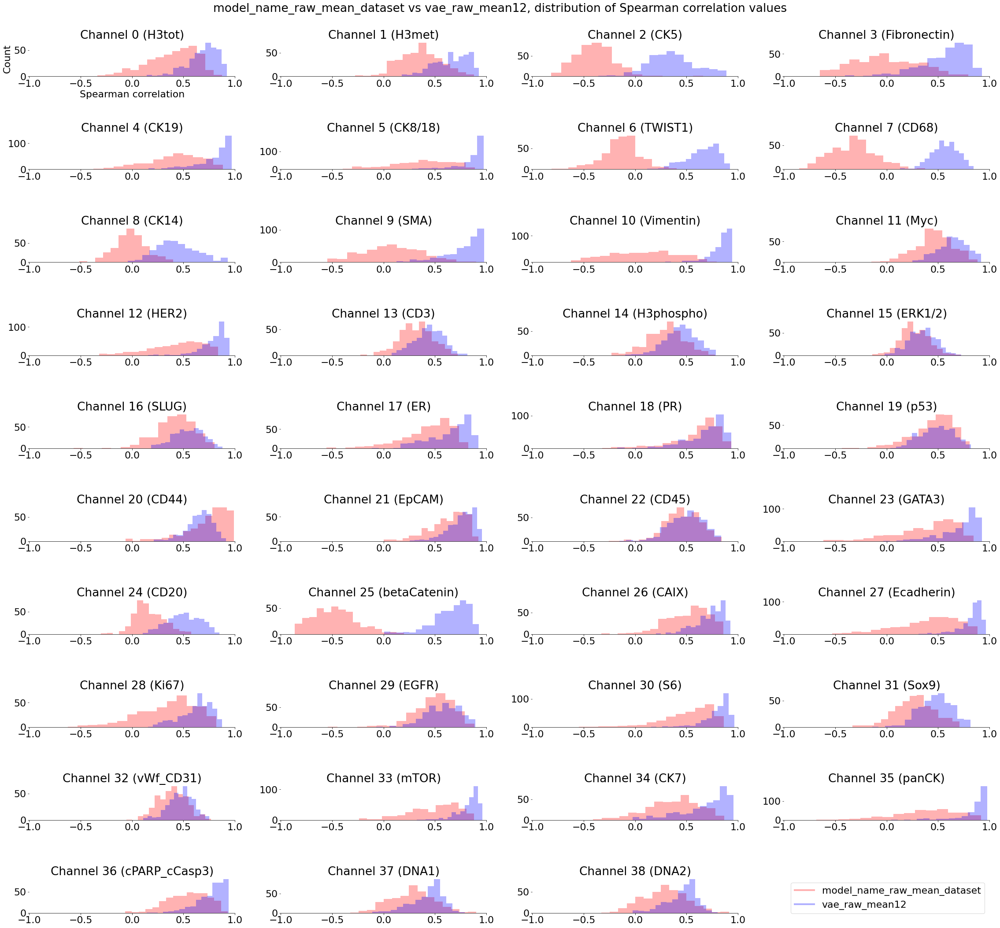

In [11]:
channel_names = ['H3tot', 'H3met', 'CK5', 'Fibronectin', 'CK19', 'CK8/18', 'TWIST1', 'CD68', 'CK14', 'SMA',
                 'Vimentin', 'Myc', 'HER2', 'CD3', 'H3phospho', 'ERK1/2', 'SLUG', 'ER', 'PR', 'p53', 'CD44',
                 'EpCAM', 'CD45', 'GATA3', 'CD20', 'betaCatenin', 'CAIX', 'Ecadherin', 'Ki67', 'EGFR', 'S6',
                 'Sox9', 'vWf_CD31', 'mTOR', 'CK7', 'panCK', 'cPARP_cCasp3', 'DNA1', 'DNA2']

n_bins = 15
fig = plt.figure(figsize=(32, 30))
import matplotlib
matplotlib.rcParams.update({'font.size': 22})
k = 1
for i in tqdm(range(39)):
    ax = plt.subplot(10, 4, k)
    k += 1
    plt.hist(raw_instance.spearman_train[:, i].flatten(), bins=n_bins, color=(1., 0., 0., 0.3))
    plt.hist(a12_instance.spearman_train[:, i].flatten(), bins=n_bins, color=(0., 0., 1., 0.3))
    ax.title.set_text(f'\nChannel {i} ({channel_names[i]})')
    ax.set_xlim([-1, 1])
    if k == 2:
        ax.set_xlabel('Spearman correlation')
        ax.set_ylabel('Count')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
#     ax.grid(axis='y')

plt.subplot(10, 4, 40)
plt.axis('off')
from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], color=(1., 0., 0., 0.3), lw=4),
                Line2D([0], [0], color=(0., 0., 1., 0.3), lw=4)]
plt.legend(custom_lines, [raw_instance.instance, a12_instance.instance])
# x = 0.05
# plt.subplots_adjust(left=x, bottom=x, right=1 - x, top=1 - x, wspace=None, hspace=0.3)
plt.suptitle(f'{raw_instance.instance} vs {a12_instance.instance}, distribution of Spearman correlation values')
plt.tight_layout()
plt.show()
matplotlib.rcParams.update(matplotlib.rcParamsDefault)
# plt.close(fig)

100%|██████████| 39/39 [00:01<00:00, 30.48it/s]


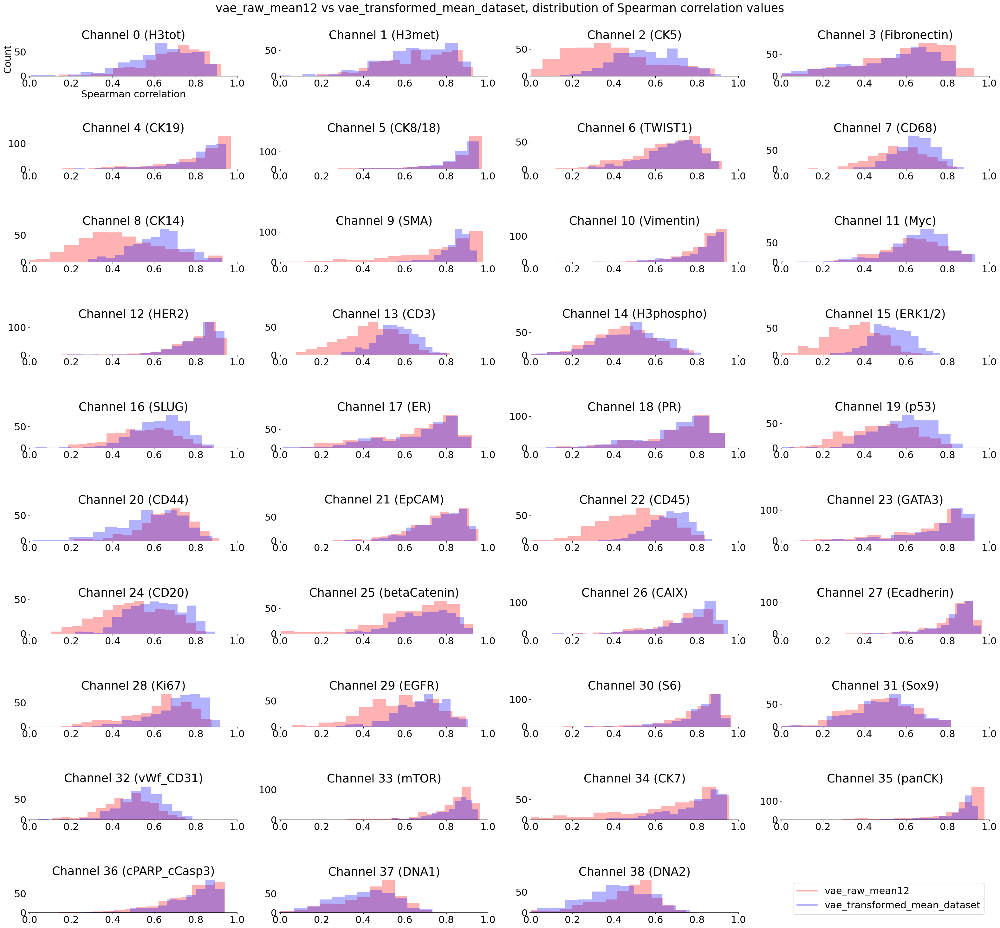

In [12]:
channel_names = ['H3tot', 'H3met', 'CK5', 'Fibronectin', 'CK19', 'CK8/18', 'TWIST1', 'CD68', 'CK14', 'SMA',
                 'Vimentin', 'Myc', 'HER2', 'CD3', 'H3phospho', 'ERK1/2', 'SLUG', 'ER', 'PR', 'p53', 'CD44',
                 'EpCAM', 'CD45', 'GATA3', 'CD20', 'betaCatenin', 'CAIX', 'Ecadherin', 'Ki67', 'EGFR', 'S6',
                 'Sox9', 'vWf_CD31', 'mTOR', 'CK7', 'panCK', 'cPARP_cCasp3', 'DNA1', 'DNA2']

n_bins = 15
fig = plt.figure(figsize=(32, 30))
import matplotlib
matplotlib.rcParams.update({'font.size': 22})
k = 1
for i in tqdm(range(39)):
    ax = plt.subplot(10, 4, k)
    k += 1
    plt.hist(a12_instance.spearman_train[:, i].flatten(), bins=n_bins, color=(1., 0., 0., 0.3))
    plt.hist(transformed_instance.spearman_train[:, i].flatten(), bins=n_bins, color=(0., 0., 1., 0.3))
    ax.title.set_text(f'\nChannel {i} ({channel_names[i]})')
    ax.set_xlim([0, 1])
    if k == 2:
        ax.set_xlabel('Spearman correlation')
        ax.set_ylabel('Count')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
#     ax.grid(axis='y')

plt.subplot(10, 4, 40)
plt.axis('off')
from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], color=(1., 0., 0., 0.3), lw=4),
                Line2D([0], [0], color=(0., 0., 1., 0.3), lw=4)]
plt.legend(custom_lines, [a12_instance.instance, transformed_instance.instance])
# x = 0.05
# plt.subplots_adjust(left=x, bottom=x, right=1 - x, top=1 - x, wspace=None, hspace=0.3)
plt.suptitle(f'{a12_instance.instance} vs {transformed_instance.instance}, distribution of Spearman correlation values')
plt.tight_layout()
plt.show()
matplotlib.rcParams.update(matplotlib.rcParamsDefault)
# plt.close(fig)

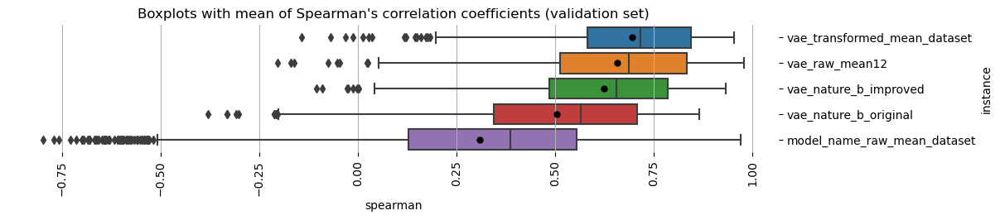

In [19]:
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go
init_notebook_mode(connected=True)

import plotly.figure_factory as ff

plt.style.use('default')

hist_data = []
group_labels = []
for instance in instances:
    v = instance.spearman_validation.flatten()
    hist_data.append(v)
    group_labels.append(instance.instance)
    
import pandas as pd
# let's order the boxplots by increasing mean
means = [np.mean(h) for h in hist_data]
s = np.array([x[1] for x in sorted(zip(means, range(len(means))), key=lambda x: -x[0])])
group_labels = [group_labels[i] for i in s]
hist_data = [hist_data[i] for i in s]
df = pd.DataFrame(dict(zip(group_labels, hist_data)))
df = df.melt().rename(columns={'variable': 'instance', 'value': 'spearman'})
import seaborn as sns
plt.figure(figsize=(12, 2))
ax = sns.boxplot(x='spearman', y='instance', data=df, orient='h', showmeans=True,
                 meanprops={
                     'marker': 'o',
                     'markerfacecolor': 'black',
                     'markeredgecolor': 'black',
                     'markersize': '5'
                 })
plt.xticks(rotation='vertical')
ax.xaxis.grid()
ax.yaxis.set_label_position("right")
ax.yaxis.tick_right()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.title('Boxplots with mean of Spearman\'s correlation coefficients (validation set)')
plt.show()

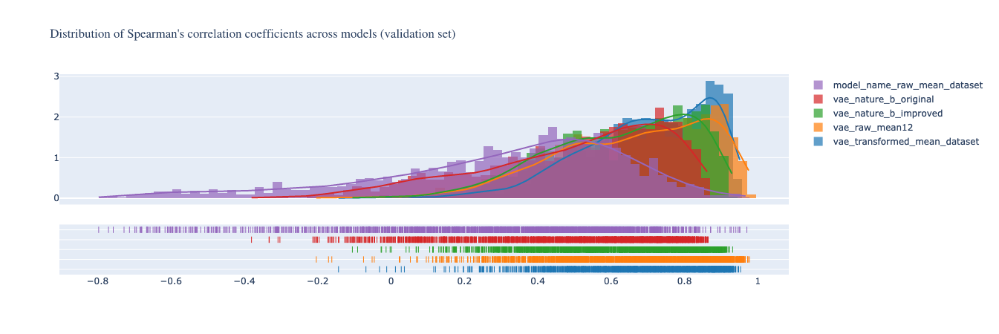

In [20]:
fig = ff.create_distplot(hist_data, group_labels, bin_size=[.025] * len(hist_data), show_rug=True)
# import plotly.express as px
# fig = px.histogram(df, x='spearman', color='instance', marginal='box')
layout = go.Layout(
    title='$\\text{Distribution of Spearman\'s correlation coefficients across models (validation set)}$',
    xaxis_title='$R^2$',
    yaxis_title='$\\text{Density estimation}$')
fig.update_layout(layout)
iplot(fig)

# Embeddings of latent space

In [9]:
import scanpy as sc
import anndata as ad

In [10]:
import numpy as np

all_k = set()
for instance in instances:
    f = the_path(instance, 'embedding_train.hdf5')
    with h5py.File(f, 'r') as f5:
        assert len(f5.keys()) == 1
        k, v = f5.items().__iter__().__next__()
        if len(all_k) == 0:
            bbb = True
        all_k.add(k)
        assert len(all_k) <= 1
        if bbb:
            print(f'EPOCH {k}')
            
        o_train = instance.ds_train.filenames        
        original_list = []
        mu_list = []
        log_var_list = []
        for i, o in enumerate(tqdm(o_train, desc='spearamn train')):
            original = instance.ds_train[i].clone().detach().numpy()
            mu = v[o]['mu'][...]
            log_var = v[o]['log_var'][...]
            assert mu.shape == log_var.shape
            assert len(original) == len(mu)
            original_list.append(original)
            mu_list.append(mu)
            log_var_list.append(log_var)
        instance.mu_list = mu_list
        instance.log_var_list = log_var_list
        
        instance.all_original = np.concatenate(original_list, axis=0)
        instance.all_mu = np.concatenate(mu_list, axis=0)
        instance.all_log_var = np.concatenate(log_var_list, axis=0)

spearamn train:   2%|▏         | 8/389 [00:00<00:05, 72.89it/s]

EPOCH epoch50


spearamn train:   2%|▏         | 8/389 [00:00<00:05, 74.54it/s]

EPOCH epoch50


spearamn train:  20%|██        | 79/389 [00:00<00:00, 788.94it/s]

EPOCH epoch50


spearamn train:  47%|████▋     | 183/389 [00:00<00:00, 1829.88it/s]

EPOCH epoch50


spearamn train:   0%|          | 0/389 [00:00<?, ?it/s]/data/l989o/deployed/a/data.py:237: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).

spearamn train:   2%|▏         | 7/389 [00:00<00:05, 64.58it/s]

EPOCH epoch50


spearamn train: 100%|██████████| 389/389 [00:06<00:00, 64.38it/s]


In [21]:
instance = instances[0]

import numpy as np
random_choice = np.random.choice(len(instance.all_original), 10000, replace=False)

In [23]:
print(instance.instance)
a0 = ad.AnnData(instance.all_original)
a1 = ad.AnnData(instance.all_mu)
a2 = ad.AnnData(instance.all_log_var)

sc.tl.pca(a0, svd_solver='arpack')

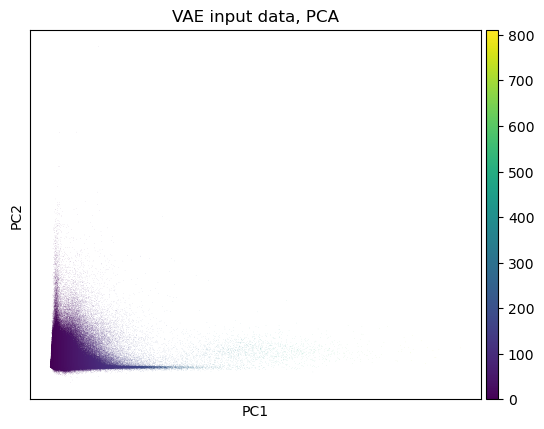

In [24]:
sc.pl.pca(a0, color='20', title='VAE input data, PCA')

model_name_raw_mean_dataset


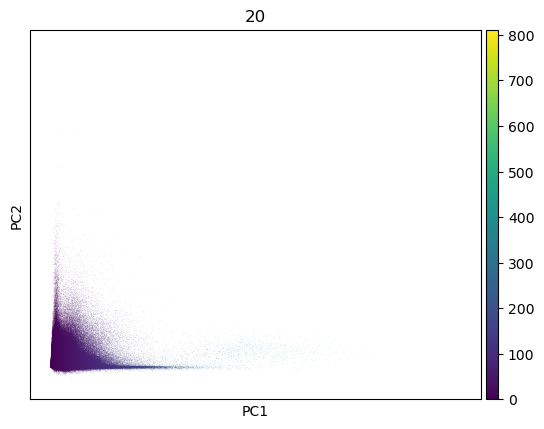

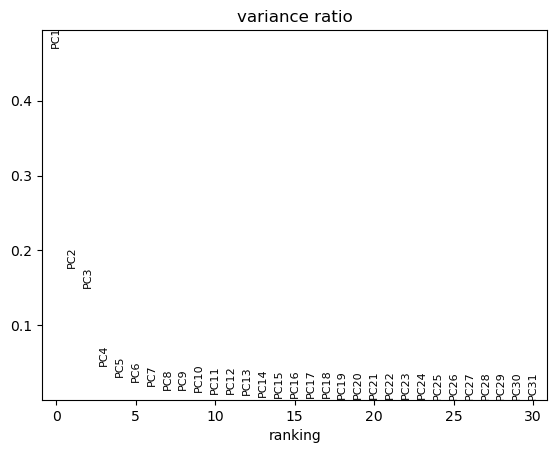

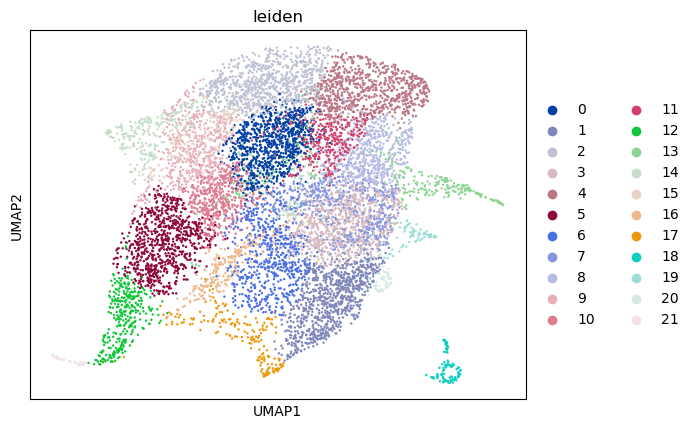

In [22]:
sc.pl.pca_variance_ratio(a0)
# sc.pl.pca_variance_ratio(a0, log=True)
b0 = a0[random_choice, :].copy()
sc.pp.neighbors(b0)
sc.tl.leiden(b0)
sc.tl.umap(b0)
sc.pl.umap(b0, color='leiden')

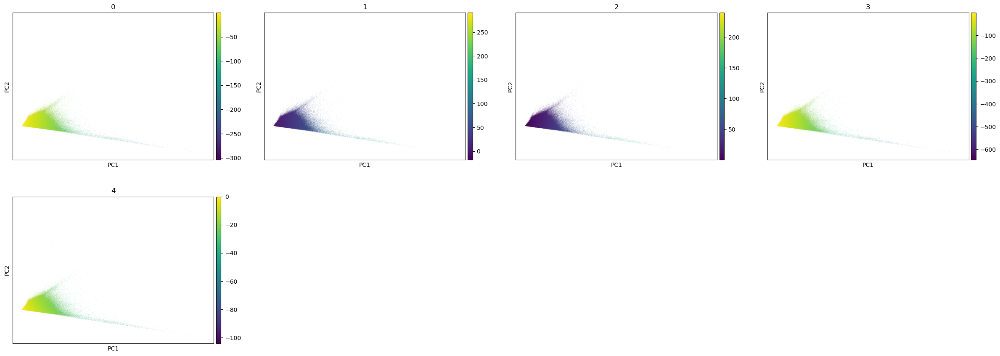

In [26]:
sc.tl.pca(a1, svd_solver='arpack')
sc.pl.pca(a1, color=['0', '1', '2', '3', '4'])

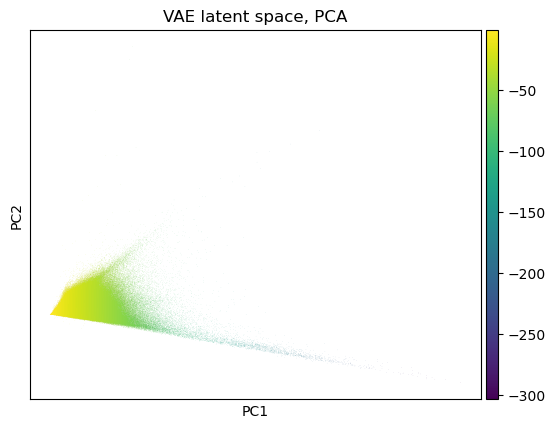

In [27]:
sc.pl.pca(a1, color='0', title='VAE latent space, PCA')

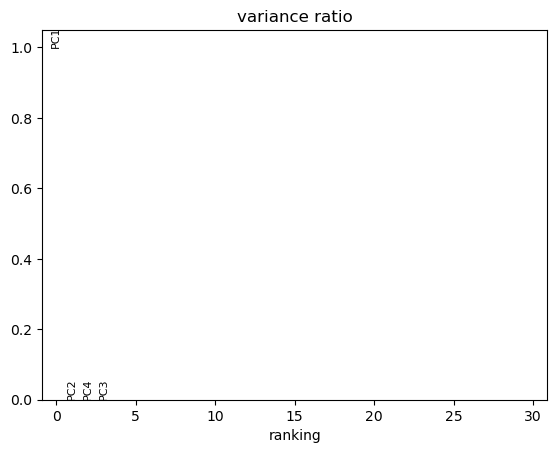

{'params': {'zero_center': True, 'use_highly_variable': False}, 'variance': array([1764.53018484,    2.02058872,    0.        ,    0.        ]), 'variance_ratio': array([0.99916923, 0.00114416, 0.        , 0.        ])}


In [28]:
sc.pl.pca_variance_ratio(a1)
print(a1.uns['pca'])
b1 = a1[random_choice, :].copy()
sc.pp.neighbors(b1)
sc.tl.leiden(b1)
sc.tl.umap(b1)

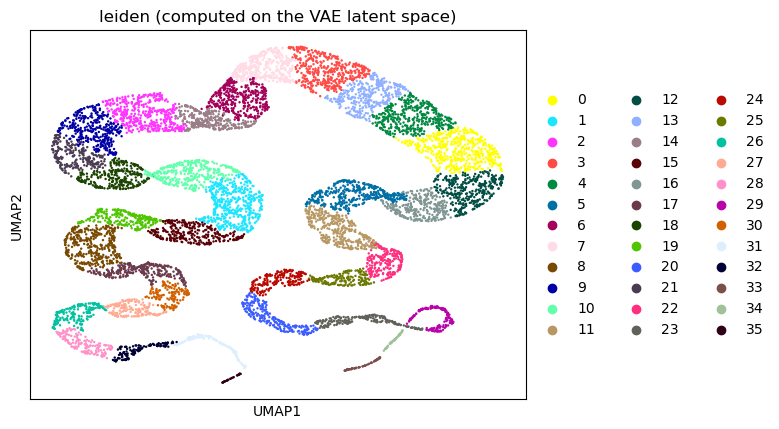

In [33]:
sc.pl.umap(b1, color='leiden', title='leiden (computed on the VAE latent space)')

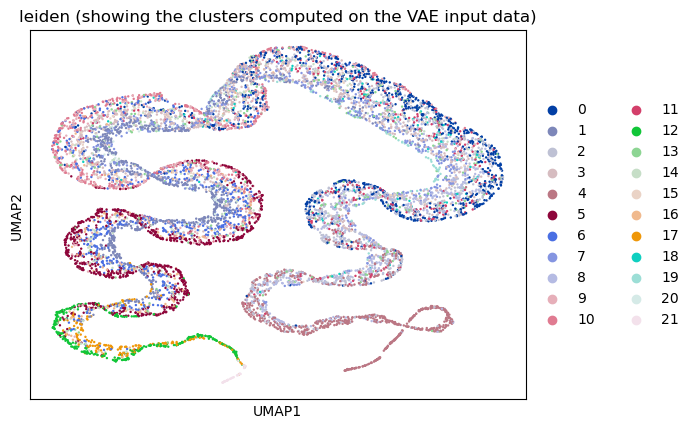

In [35]:
b1.obs['leiden_b0'] = b0.obs['leiden']
sc.pl.umap(b1, color='leiden_b0', title='leiden (showing the clusters computed on the VAE input data)')

vae_raw_mean12


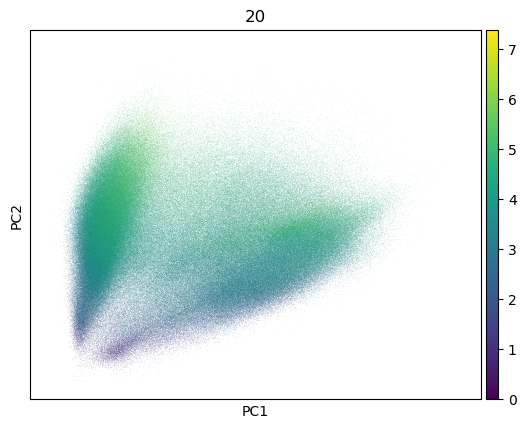

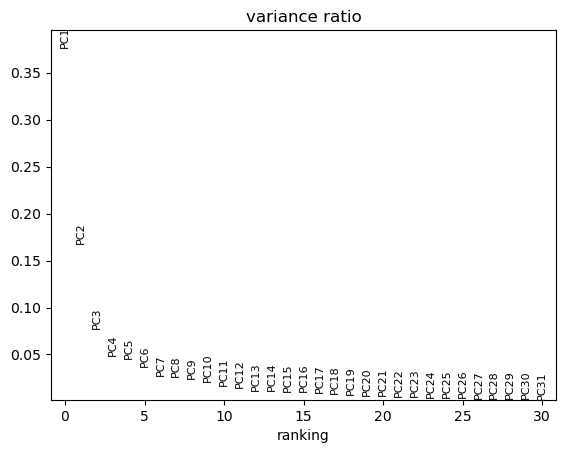

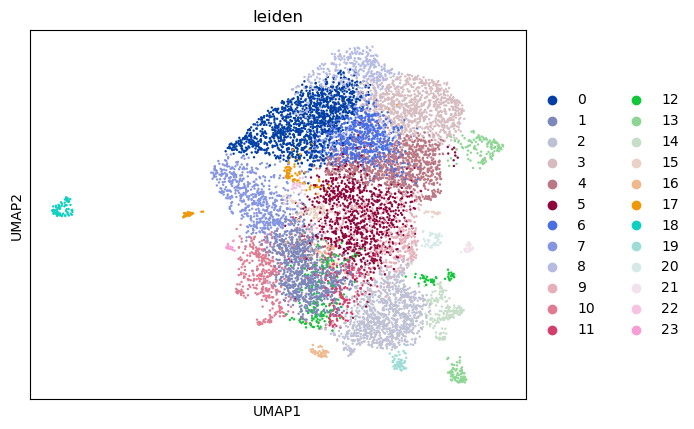

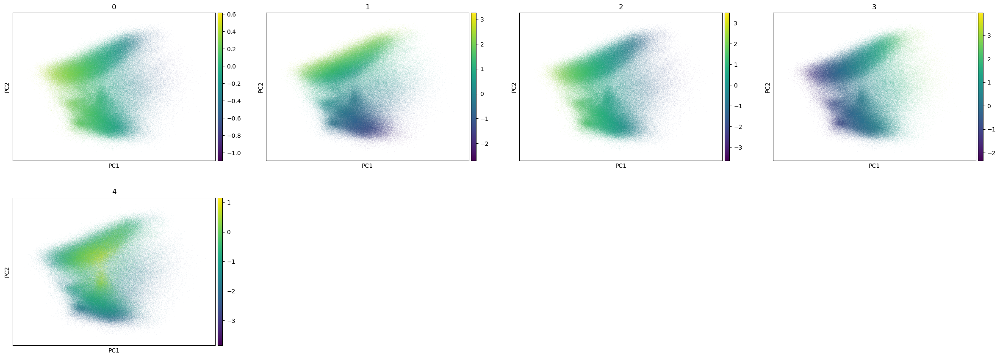

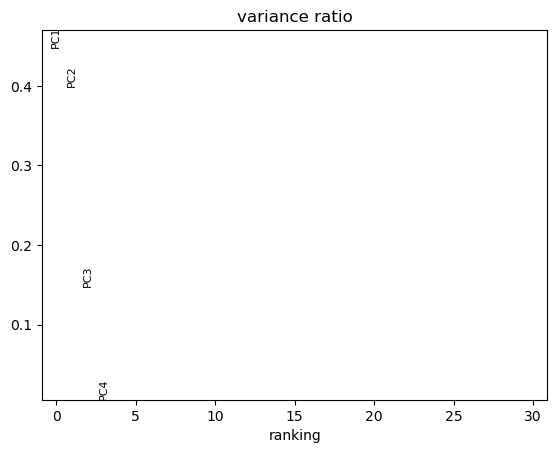

{'params': {'zero_center': True, 'use_highly_variable': False}, 'variance': array([1.48541506, 1.32146673, 0.49051944, 0.01894385]), 'variance_ratio': array([0.44774553, 0.39832693, 0.14785624, 0.0057102 ])}


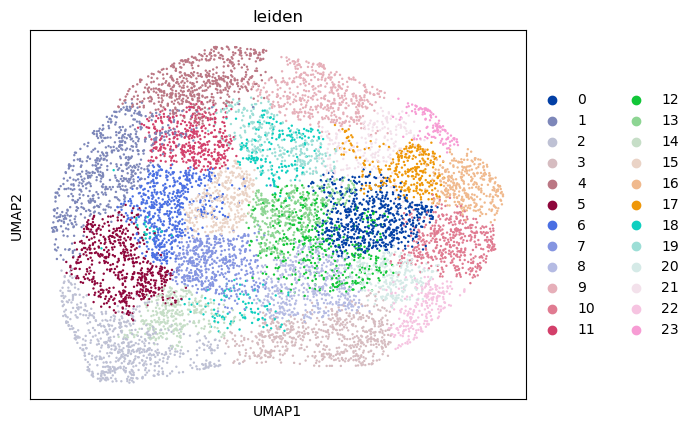

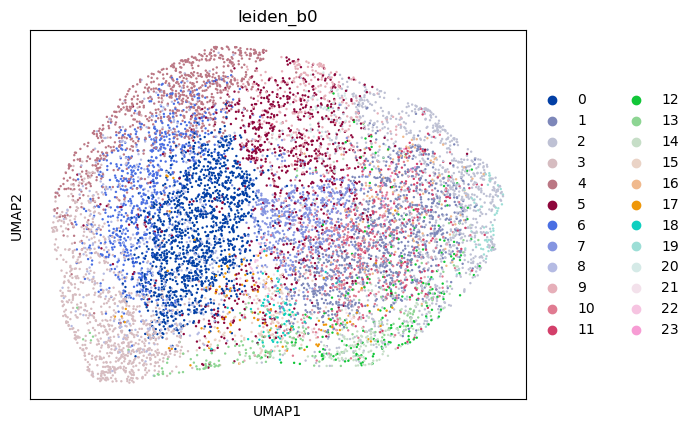

In [21]:
instance = instances[1]

print(instance.instance)
a0 = ad.AnnData(instance.all_original)
a1 = ad.AnnData(instance.all_mu)
a2 = ad.AnnData(instance.all_log_var)

sc.tl.pca(a0, svd_solver='arpack')
sc.pl.pca(a0, color='20')
sc.pl.pca_variance_ratio(a0)
# sc.pl.pca_variance_ratio(a0, log=True)
b0 = a0[random_choice, :].copy()
sc.pp.neighbors(b0)
sc.tl.leiden(b0)
sc.tl.umap(b0)
sc.pl.umap(b0, color='leiden')

sc.tl.pca(a1, svd_solver='arpack')
sc.pl.pca(a1, color=['0', '1', '2', '3', '4'])
sc.pl.pca_variance_ratio(a1)
print(a1.uns['pca'])
b1 = a1[random_choice, :].copy()
sc.pp.neighbors(b1)
sc.tl.leiden(b1)
sc.tl.umap(b1)
sc.pl.umap(b1, color='leiden')

b1.obs['leiden_b0'] = b0.obs['leiden']
sc.pl.umap(b1, color='leiden_b0')

vae_nature_b_improved


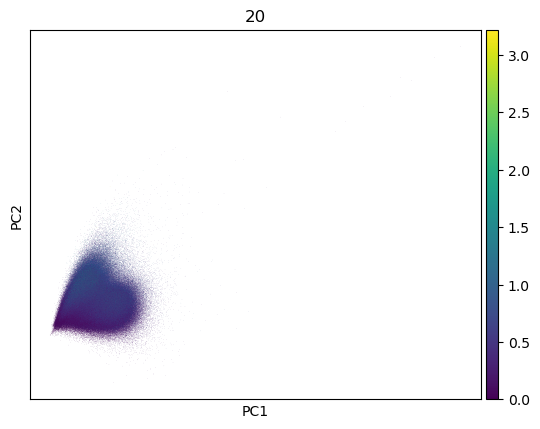

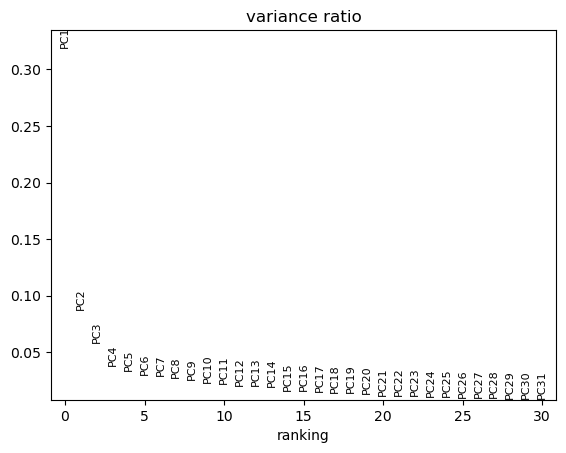

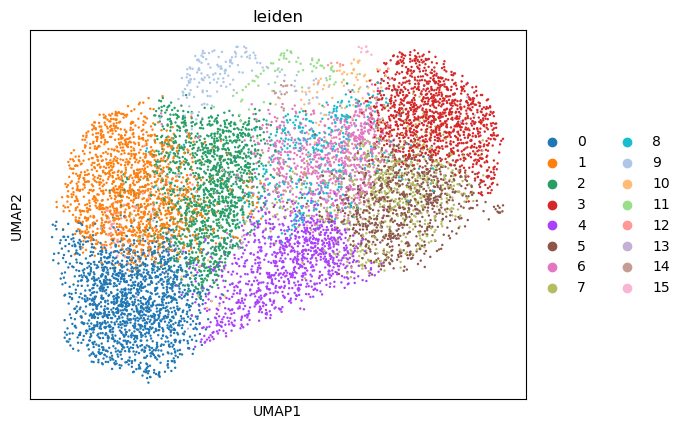

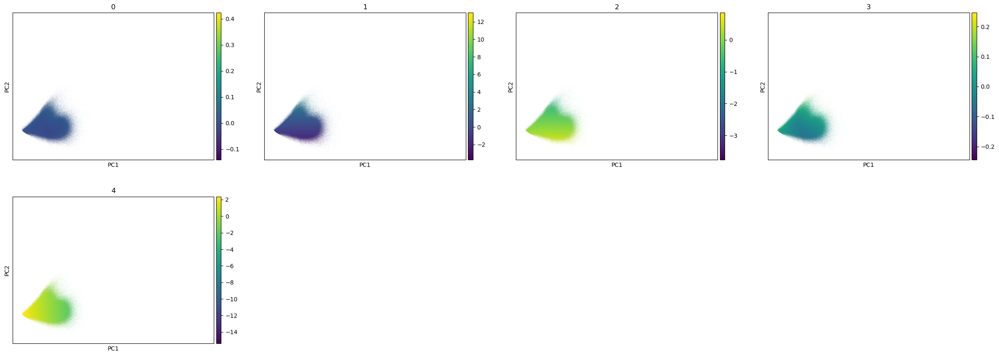

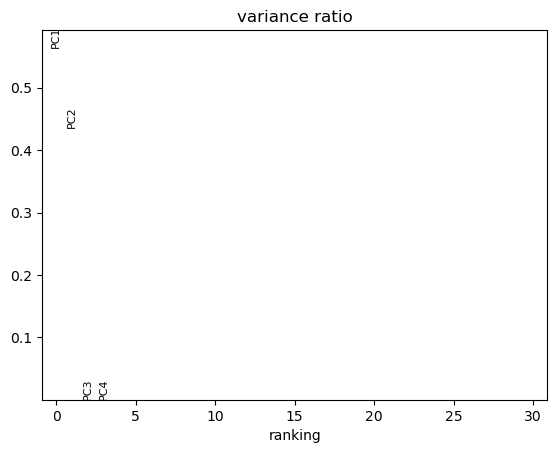

{'params': {'zero_center': True, 'use_highly_variable': False}, 'variance': array([9.58020186e-01, 7.40172696e-01, 4.76719723e-04, 1.57412449e-04]), 'variance_ratio': array([5.64062629e-01, 4.35798496e-01, 2.80682792e-04, 9.26812203e-05])}


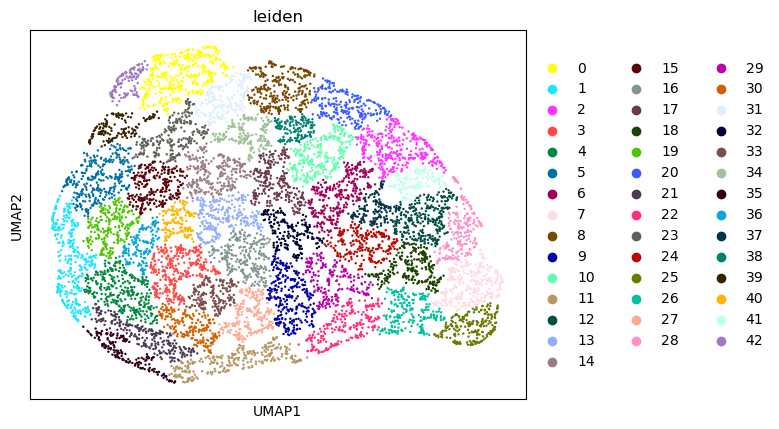

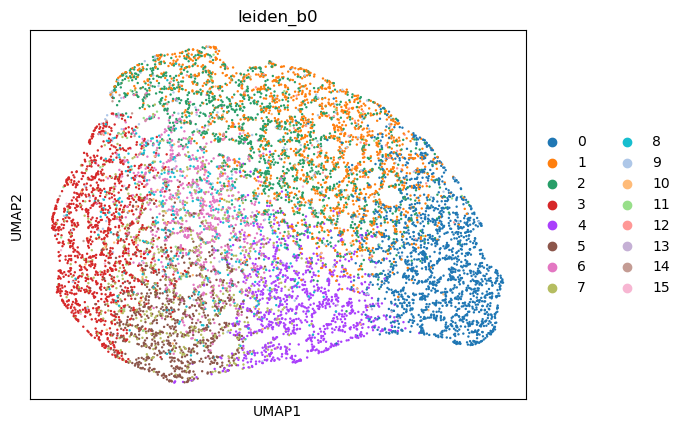

In [22]:
instance = instances[2]

print(instance.instance)
a0 = ad.AnnData(instance.all_original)
a1 = ad.AnnData(instance.all_mu)
a2 = ad.AnnData(instance.all_log_var)

sc.tl.pca(a0, svd_solver='arpack')
sc.pl.pca(a0, color='20')
sc.pl.pca_variance_ratio(a0)
# sc.pl.pca_variance_ratio(a0, log=True)
b0 = a0[random_choice, :].copy()
sc.pp.neighbors(b0)
sc.tl.leiden(b0)
sc.tl.umap(b0)
sc.pl.umap(b0, color='leiden')

sc.tl.pca(a1, svd_solver='arpack')
sc.pl.pca(a1, color=['0', '1', '2', '3', '4'])
sc.pl.pca_variance_ratio(a1)
print(a1.uns['pca'])
b1 = a1[random_choice, :].copy()
sc.pp.neighbors(b1)
sc.tl.leiden(b1)
sc.tl.umap(b1)
sc.pl.umap(b1, color='leiden')

b1.obs['leiden_b0'] = b0.obs['leiden']
sc.pl.umap(b1, color='leiden_b0')

vae_nature_b_original


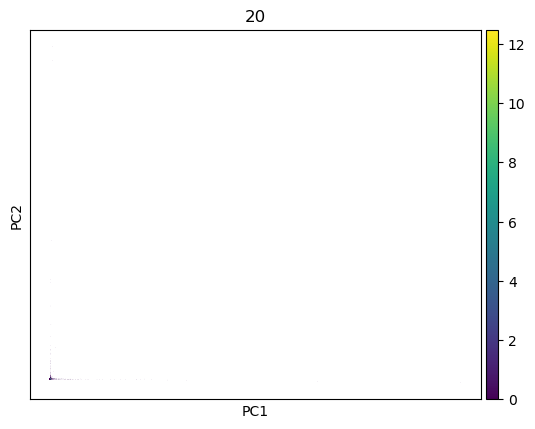

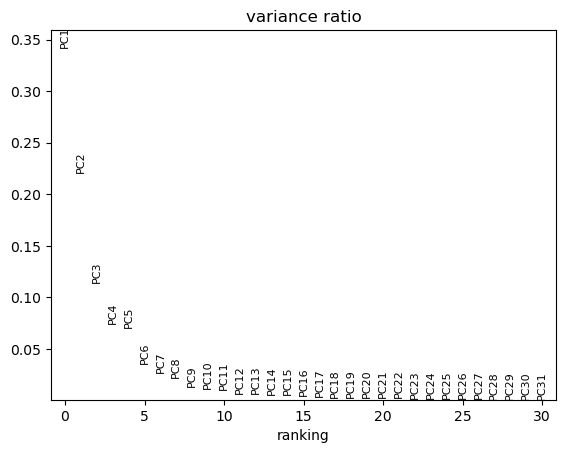

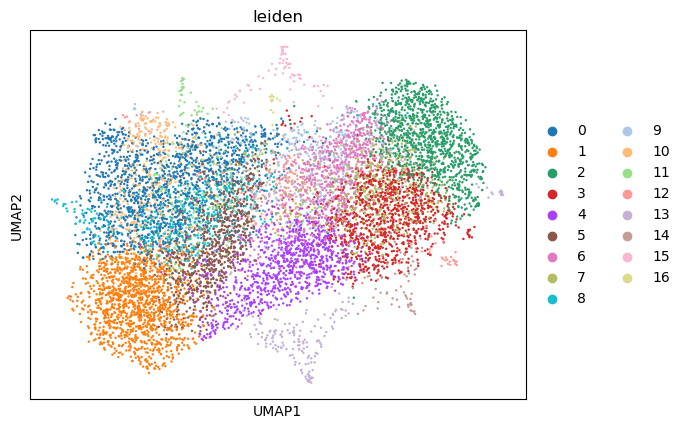

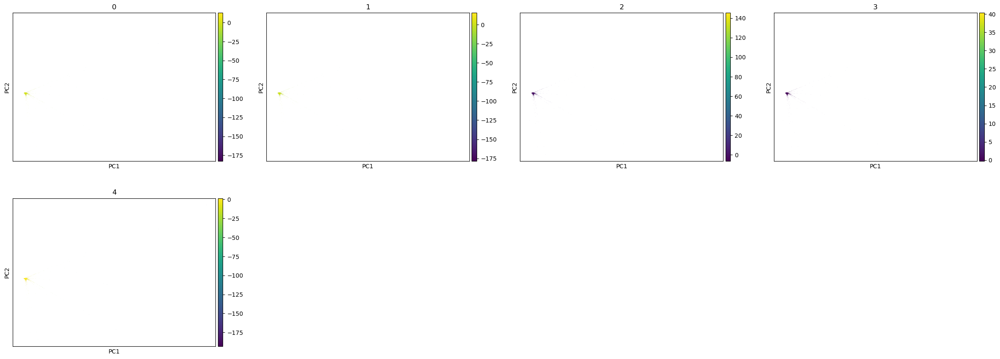

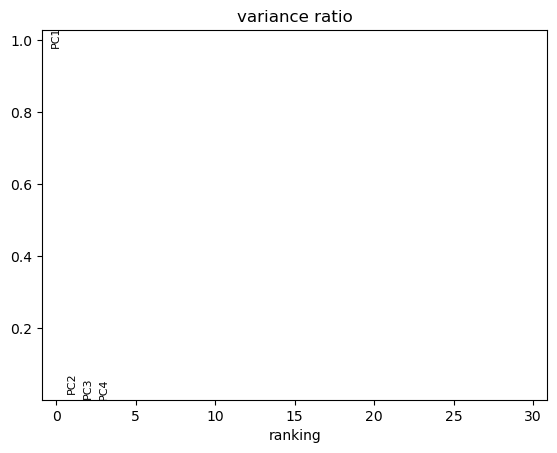

{'params': {'zero_center': True, 'use_highly_variable': False}, 'variance': array([1.45972322e+00, 2.36960744e-02, 5.98151048e-03, 8.76123375e-04]), 'variance_ratio': array([9.79788419e-01, 1.59051654e-02, 4.01488078e-03, 5.88067330e-04])}


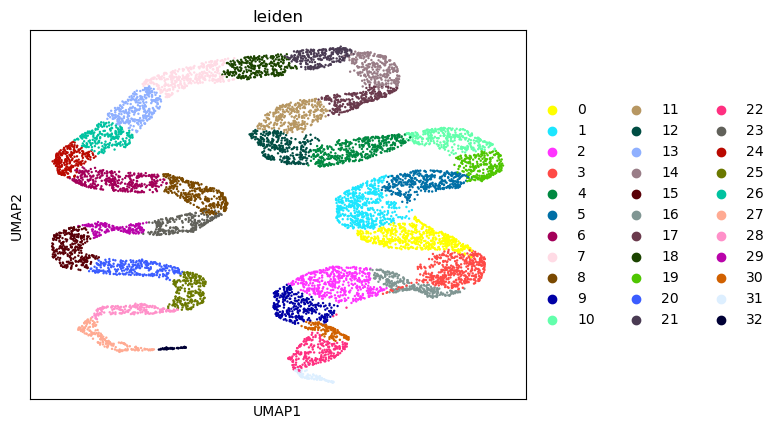

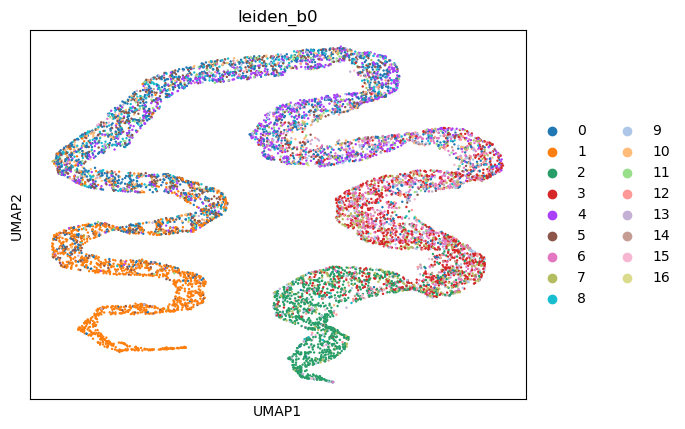

In [23]:
instance = instances[3]

print(instance.instance)
a0 = ad.AnnData(instance.all_original)
a1 = ad.AnnData(instance.all_mu)
a2 = ad.AnnData(instance.all_log_var)

sc.tl.pca(a0, svd_solver='arpack')
sc.pl.pca(a0, color='20')
sc.pl.pca_variance_ratio(a0)
# sc.pl.pca_variance_ratio(a0, log=True)
b0 = a0[random_choice, :].copy()
sc.pp.neighbors(b0)
sc.tl.leiden(b0)
sc.tl.umap(b0)
sc.pl.umap(b0, color='leiden')

sc.tl.pca(a1, svd_solver='arpack')
sc.pl.pca(a1, color=['0', '1', '2', '3', '4'])
sc.pl.pca_variance_ratio(a1)
print(a1.uns['pca'])
b1 = a1[random_choice, :].copy()
sc.pp.neighbors(b1)
sc.tl.leiden(b1)
sc.tl.umap(b1)
sc.pl.umap(b1, color='leiden')

b1.obs['leiden_b0'] = b0.obs['leiden']
sc.pl.umap(b1, color='leiden_b0')

## Transformed mean dataset

### Train

In [73]:
instance = instances[4]

print(instance.instance)
a0 = ad.AnnData(instance.all_original)
a1 = ad.AnnData(instance.all_mu)
a2 = ad.AnnData(instance.all_log_var)

sc.tl.pca(a0, svd_solver='arpack')

vae_transformed_mean_dataset


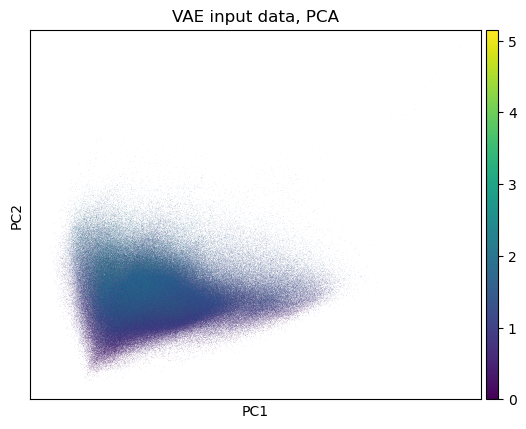

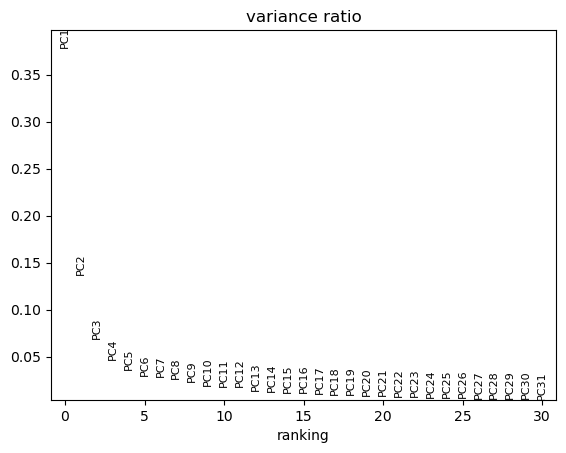

In [42]:
sc.pl.pca(a0, color='20', title='VAE input data, PCA')
sc.pl.pca_variance_ratio(a0)

In [36]:
# sc.pl.pca_variance_ratio(a0, log=True)
b0 = a0[random_choice, :].copy()
sc.pp.neighbors(b0)
sc.tl.leiden(b0)
sc.tl.umap(b0)
sc.pl.umap(b0, color='leiden')

sc.tl.pca(a1, svd_solver='arpack')

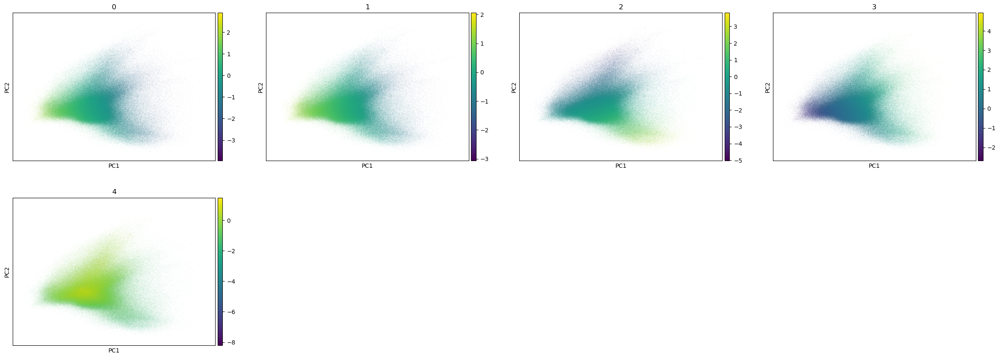

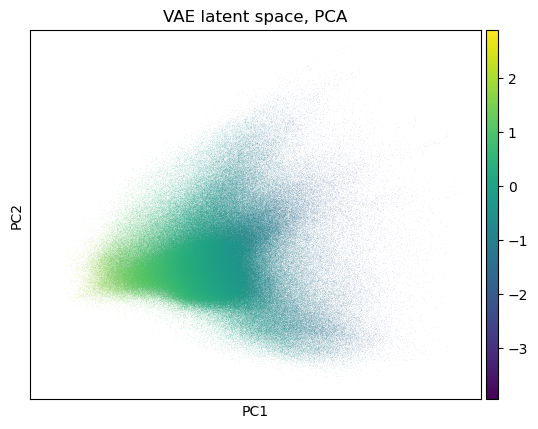

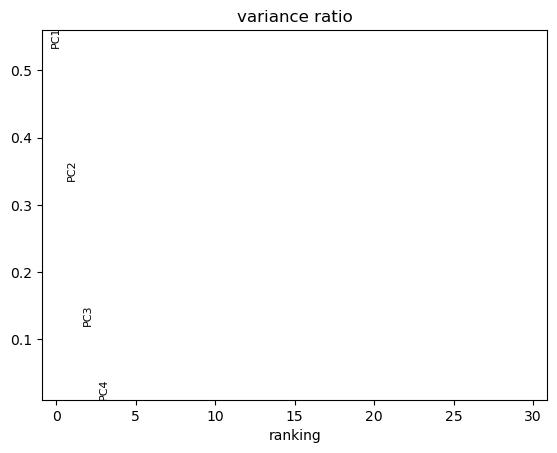

In [45]:
sc.pl.pca(a1, color=['0', '1', '2', '3', '4'])
sc.pl.pca(a1, color='0', title='VAE latent space, PCA')
sc.pl.pca_variance_ratio(a1)

In [47]:
print(a1.uns['pca'])
a1

{'params': {'zero_center': True, 'use_highly_variable': False}, 'variance': array([1.5715738 , 0.99103835, 0.35287942, 0.03093377]), 'variance_ratio': array([0.53333943, 0.33632517, 0.11975544, 0.01049788])}


AnnData object with n_obs × n_vars = 762354 × 5
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [36]:
b1 = a1[random_choice, :].copy()
sc.pp.neighbors(b1)
sc.tl.leiden(b1)
sc.tl.umap(b1)
sc.pl.umap(b1, color='leiden')

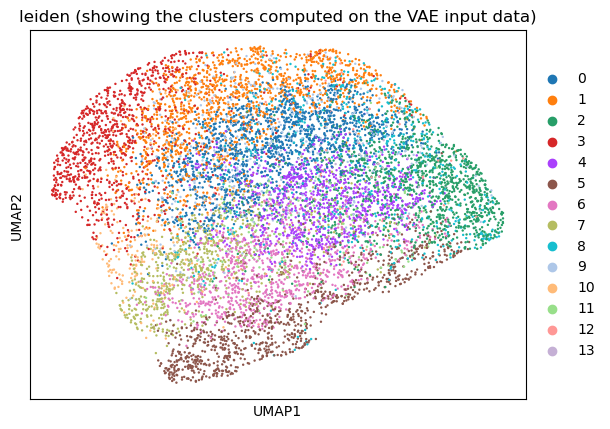

In [48]:
b1.obs['leiden_b0'] = b0.obs['leiden']
sc.pl.umap(b1, color='leiden_b0', title='leiden (showing the clusters computed on the VAE input data)')

In [74]:
print(a0)
print(a1)
print(b0)
print(b1)

AnnData object with n_obs × n_vars = 762354 × 39
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
AnnData object with n_obs × n_vars = 762354 × 5
AnnData object with n_obs × n_vars = 10000 × 39
    obs: 'leiden'
    uns: 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
AnnData object with n_obs × n_vars = 10000 × 5
    obs: 'leiden', 'leiden_b0'
    uns: 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors', 'leiden_b0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


### Train + validation

In [92]:
import numpy as np

instance = instances[4]
print(instance.instance)

vae_transformed_mean_dataset


In [93]:
all_k = set()
f = the_path(instance, 'embedding_train.hdf5')
with h5py.File(f, 'r') as f5:
    assert len(f5.keys()) == 1
    k, v = f5.items().__iter__().__next__()
    if len(all_k) == 0:
        bbb = True
    all_k.add(k)
    assert len(all_k) <= 1
    if bbb:
        print(f'EPOCH {k}')

    o_train = instance.ds_train.filenames        
    original_list = []
    mu_list = []
    log_var_list = []
    for i, o in enumerate(tqdm(o_train, desc='spearamn train')):
        original = instance.ds_train[i].clone().detach().numpy()
        mu = v[o]['mu'][...]
        log_var = v[o]['log_var'][...]
        assert mu.shape == log_var.shape
        assert len(original) == len(mu)
        original_list.append(original)
        mu_list.append(mu)
        log_var_list.append(log_var)
    instance.mu_list = mu_list
    instance.log_var_list = log_var_list

    instance.train_all_original = np.concatenate(original_list, axis=0)
    instance.train_all_mu = np.concatenate(mu_list, axis=0)
    instance.train_all_log_var = np.concatenate(log_var_list, axis=0)

spearamn train:   0%|          | 0/389 [00:00<?, ?it/s]/data/l989o/deployed/a/data.py:237: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).

spearamn train:   2%|▏         | 6/389 [00:00<00:07, 52.08it/s]

EPOCH epoch50


spearamn train: 100%|██████████| 389/389 [00:07<00:00, 52.86it/s]


In [94]:
all_k = set()
f = the_path(instance, 'embedding_validation.hdf5')
with h5py.File(f, 'r') as f5:
    assert len(f5.keys()) == 1
    k, v = f5.items().__iter__().__next__()
    if len(all_k) == 0:
        bbb = True
    all_k.add(k)
    assert len(all_k) <= 1
    if bbb:
        print(f'EPOCH {k}')
    o_validation = instance.ds_validation.filenames        
    original_list = []
    mu_list = []
    log_var_list = []
    for i, o in enumerate(tqdm(o_validation, desc='spearamn validation')):
        original = instance.ds_validation[i].clone().detach().numpy()
        mu = v[o]['mu'][...]
        log_var = v[o]['log_var'][...]
        assert mu.shape == log_var.shape
        assert len(original) == len(mu)
        original_list.append(original)
        mu_list.append(mu)
        log_var_list.append(log_var)
    instance.mu_list = mu_list
    instance.log_var_list = log_var_list

    instance.validation_all_original = np.concatenate(original_list, axis=0)
    instance.validation_all_mu = np.concatenate(mu_list, axis=0)
    instance.validation_all_log_var = np.concatenate(log_var_list, axis=0)

spearamn validation:  33%|███▎      | 15/45 [00:00<00:00, 139.12it/s]

EPOCH epoch50


spearamn validation: 100%|██████████| 45/45 [00:00<00:00, 153.96it/s]


In [127]:
m = len(instance.train_all_original)
n = len(instance.validation_all_original)

print(m, n)

import numpy as np
random_choice = np.random.choice(m + n, 10000, replace=False)
mm = np.array([i for i, a in enumerate(random_choice) if a < m])
nn = np.array([i for i, a in enumerate(random_choice) if a >= m])

print(len(mm), len(nn))

762354 92298
8925 1075


In [96]:
x = np.concatenate((instance.train_all_original, instance.validation_all_original), axis=0)
x_mu = np.concatenate((instance.train_all_mu, instance.validation_all_mu), axis=0)
x_log_var = np.concatenate((instance.train_all_log_var, instance.validation_all_log_var), axis=0)

a = ad.AnnData(x)
a_mu = ad.AnnData(x_mu)
a_log_var = ad.AnnData(x_log_var)

In [97]:
print(instance.instance)

vae_transformed_mean_dataset


In [102]:
a

AnnData object with n_obs × n_vars = 854652 × 39
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

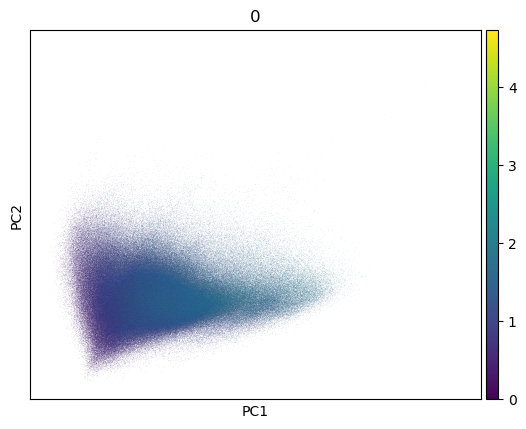

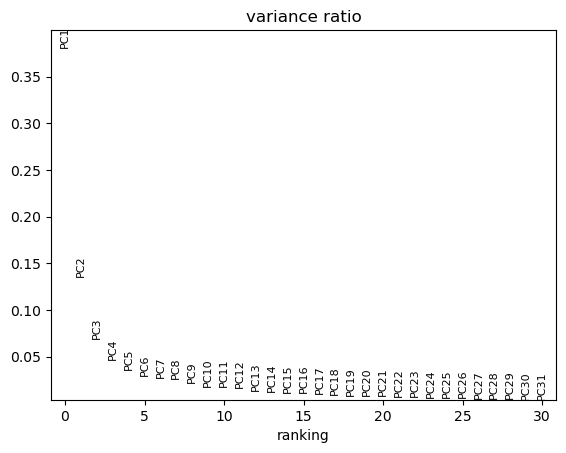

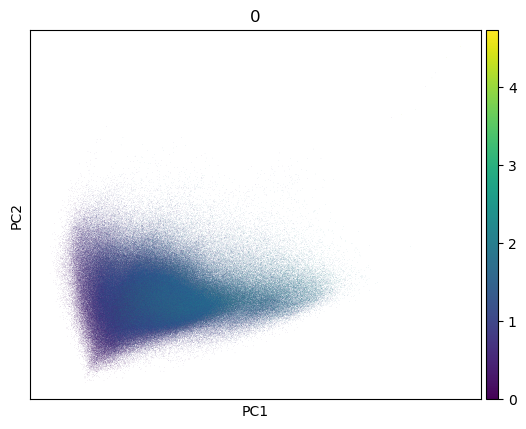

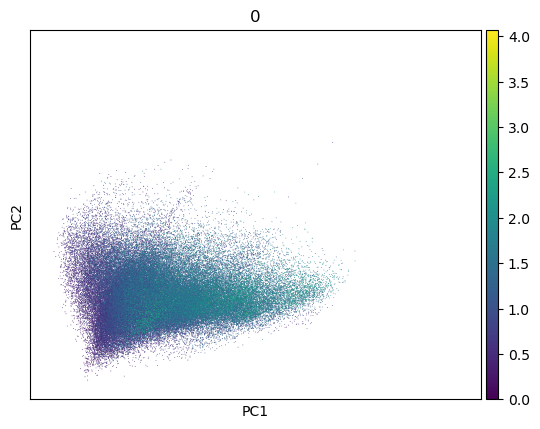

In [115]:
sc.tl.pca(a, svd_solver='arpack')

ax = sc.pl.pca(a, color='0', show=False)
xlim = ax.get_xlim()
ylim = ax.get_ylim()
plt.show()
sc.pl.pca_variance_ratio(a)
# sc.pl.pca_variance_ratio(a0, log=True)

ax = sc.pl.pca(a[: m], color='0', show=False)
plt.xlim(xlim)
plt.ylim(ylim)
plt.show()

sc.pl.pca(a[m: ], color='0', show=False)
plt.xlim(xlim)
plt.ylim(ylim)
plt.show()

In [99]:
b = a[random_choice, :].copy()
sc.pp.neighbors(b)
sc.tl.leiden(b)
sc.tl.umap(b)

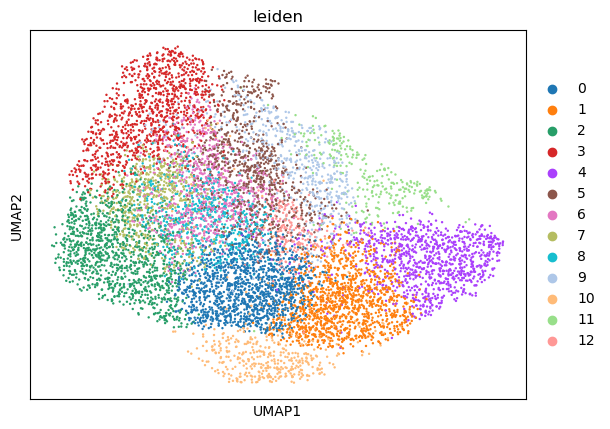

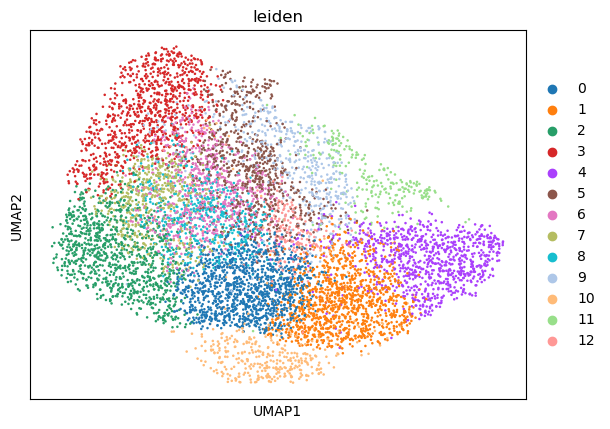

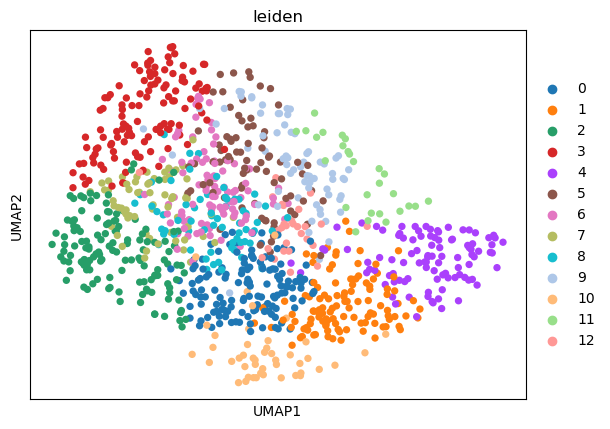

In [129]:
sc.pl.umap(b, color='leiden')
sc.pl.umap(b[mm, :], color='leiden')
sc.pl.umap(b[nn, :], color='leiden')

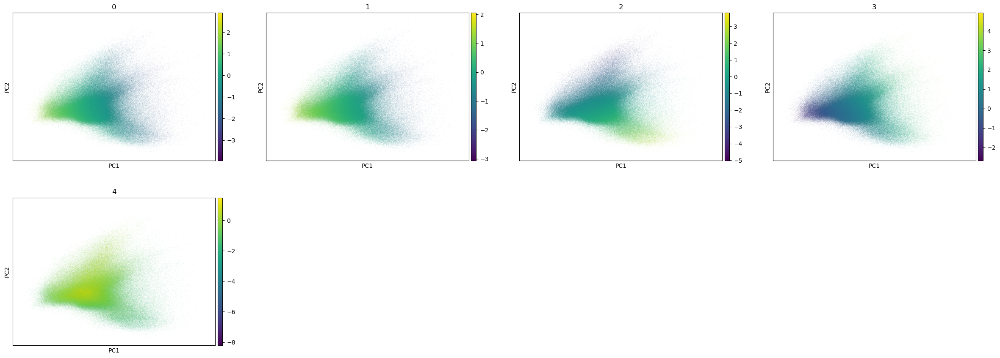

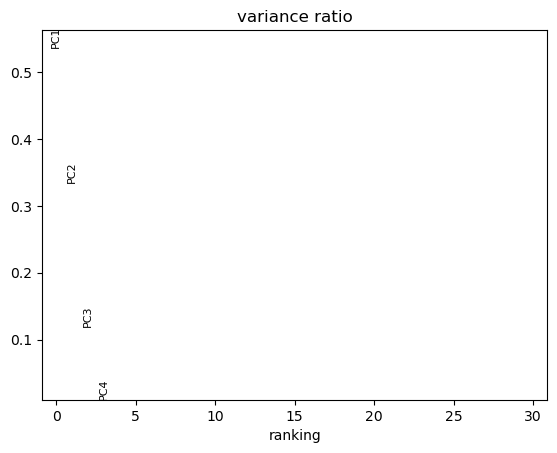

{'params': {'zero_center': True, 'use_highly_variable': False}, 'variance': array([1.60156412, 0.99876989, 0.35396199, 0.03118763]), 'variance_ratio': array([0.53644019, 0.33453566, 0.11855875, 0.01044622])}


In [100]:
sc.tl.pca(a_mu, svd_solver='arpack')
sc.pl.pca(a_mu, color=['0', '1', '2', '3', '4'])
sc.pl.pca_variance_ratio(a_mu)
print(a_mu.uns['pca'])

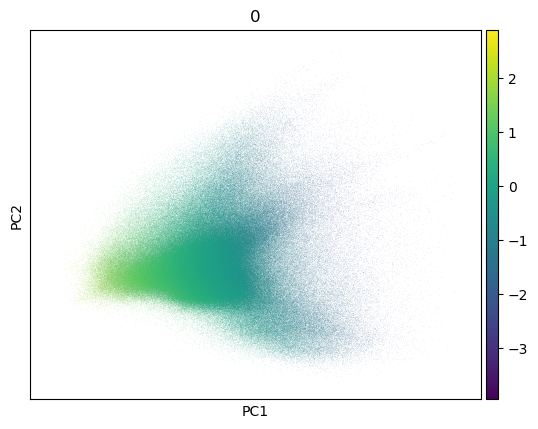

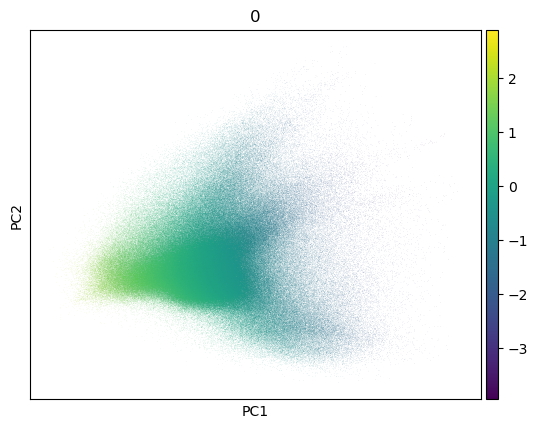

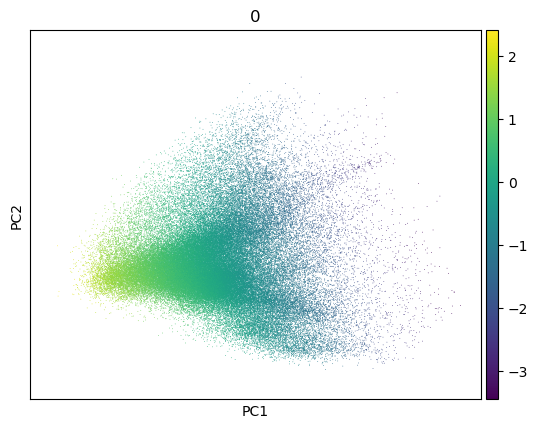

In [130]:
ax = sc.pl.pca(a_mu, color='0', show=False)
xlim = ax.get_xlim()
ylim = ax.get_ylim()
plt.show()

ax = sc.pl.pca(a_mu[: m], color='0', show=False)
plt.xlim(xlim)
plt.ylim(ylim)
plt.show()

sc.pl.pca(a_mu[m: ], color='0', show=False)
plt.xlim(xlim)
plt.ylim(ylim)
plt.show()

In [101]:
b_mu = a_mu[random_choice, :].copy()
sc.pp.neighbors(b_mu)
sc.tl.leiden(b_mu)
sc.tl.umap(b_mu)

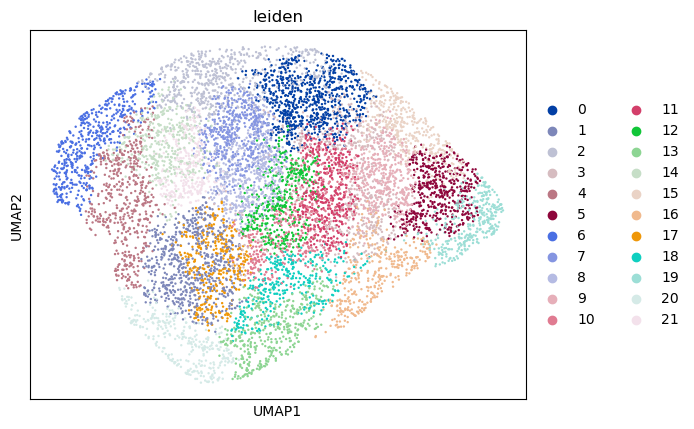

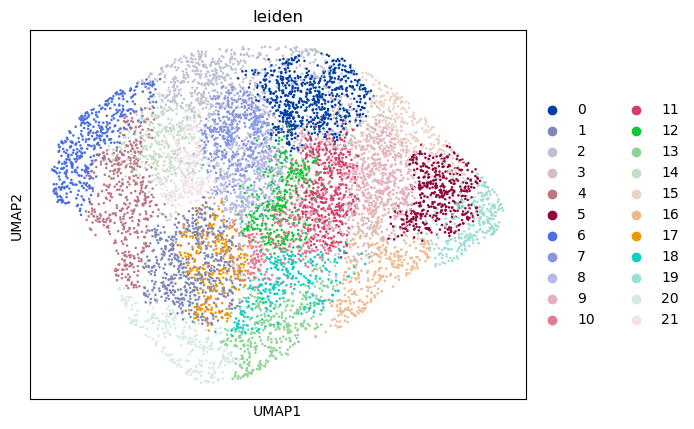

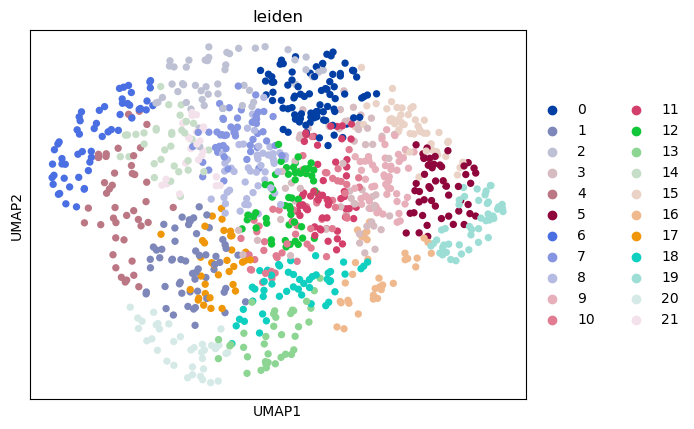

In [131]:
sc.pl.umap(b_mu, color='leiden')
sc.pl.umap(b_mu[mm], color='leiden')
sc.pl.umap(b_mu[nn], color='leiden')

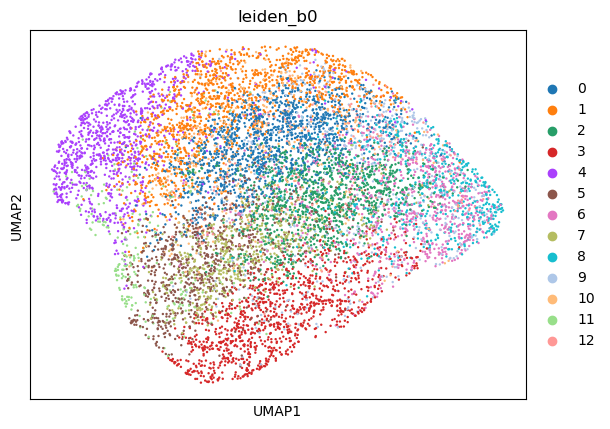

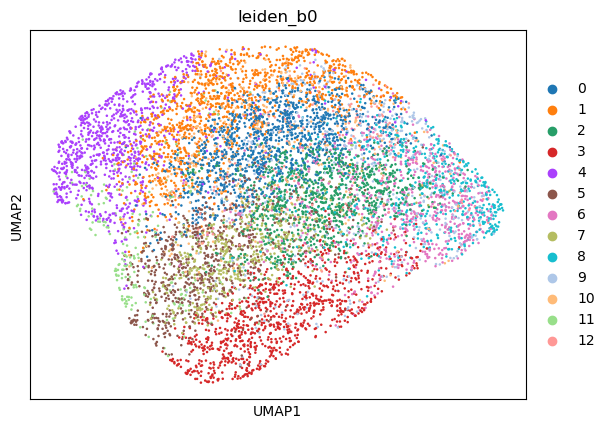

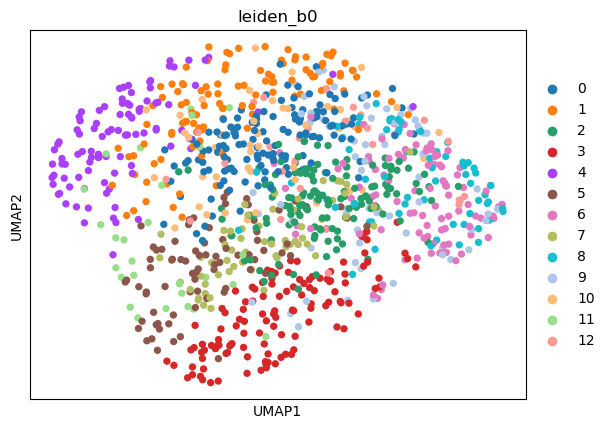

In [132]:
b_mu.obs['leiden_b0'] = b.obs['leiden']
sc.pl.umap(b_mu, color='leiden_b0')
sc.pl.umap(b_mu[mm], color='leiden_b0')
sc.pl.umap(b_mu[nn], color='leiden_b0')

# Assessing mixing

In [14]:
import math

"""
a12_instance, = [i for i in instances if i.instance == 'vae_raw_mean12']
transformed_instance, = [i for i in instances if i.instance == 'vae_transformed_mean_dataset']
nature_improved_instance, = [i for i in instances if i.instance == 'vae_nature_b_improved']
raw_instance, = [i for i in instances if i.instance == 'model_name_raw_mean_dataset']
"""

"\na12_instance, = [i for i in instances if i.instance == 'vae_raw_mean12']\ntransformed_instance, = [i for i in instances if i.instance == 'vae_transformed_mean_dataset']\nnature_improved_instance, = [i for i in instances if i.instance == 'vae_nature_b_improved']\nraw_instance, = [i for i in instances if i.instance == 'model_name_raw_mean_dataset']\n"

In [17]:
import torch
list_of_t = []
list_of_patient_index = []
for i, t in enumerate(tqdm(instances[0].ds_train)):
    list_of_t.append(t)
    ii = torch.tensor([i] * len(t))
    list_of_patient_index.append(ii)
t_train = torch.cat(list_of_t, dim=0)
patient_indexes = torch.cat(list_of_patient_index)
print(t_train.shape)

100%|██████████| 389/389 [00:04<00:00, 78.46it/s]

torch.Size([762354, 39])


In [151]:
mmm = random_choice[random_choice < m]
p = patient_indexes[mmm]
u = b_mu.obsm['X_umap'][mm]

print(len(p))
print(u.shape)

random_colors = np.random.random((10000, 3))
c = random_colors[p, :]

8925
(8925, 2)


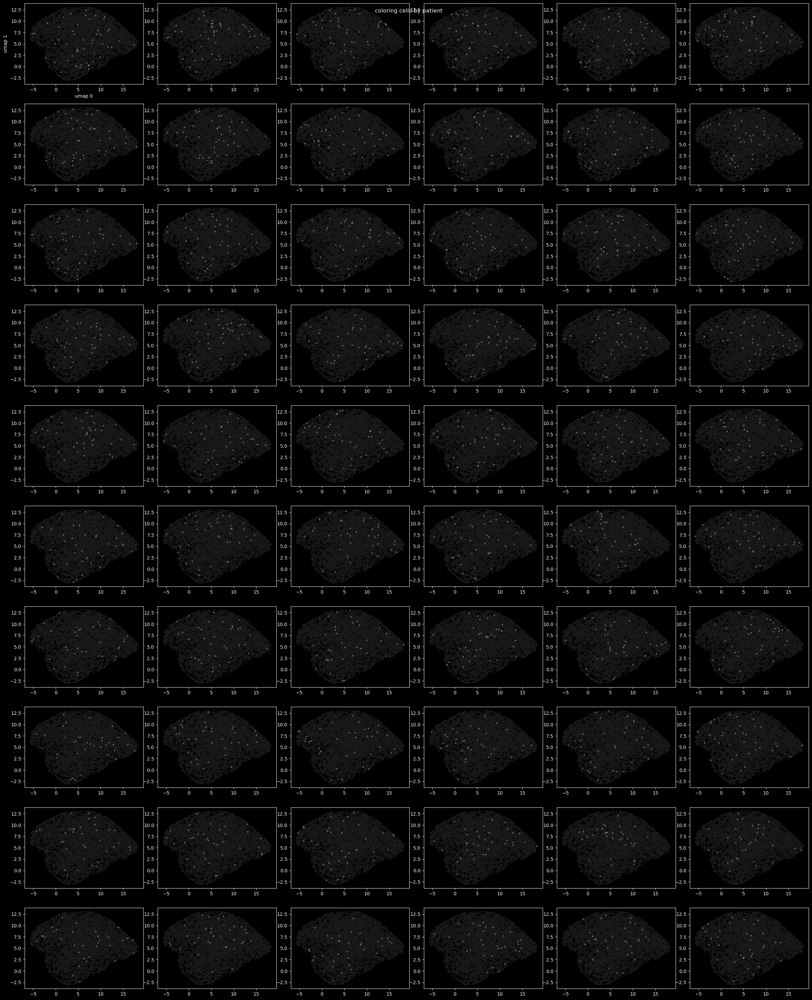

In [146]:
plt.style.use('dark_background')

n = 60
c = 6
r = math.ceil(n / c)

fig, axes = plt.subplots(r, c, figsize=(c * 4, r * 3))
axes = axes.flatten()

unique, counts = np.unique(p, return_counts=True)
uu, cc = map(list, zip(*sorted(zip(unique, counts), key=lambda x: -x[1])))
top = uu[:n]

b = True
for i, t in enumerate(top):
    ax = axes[i]
    if b:
        b = False
        ax.set_xlabel('umap 0')
        ax.set_ylabel('umap 1')
    one_color = np.array([0.1, 0.1, 0.1, 1.]).reshape((1, 4))
    colors = np.tile(one_color, (len(u), 1))
    ax.scatter(u[:, 0], u[:, 1], c=colors, s=2)
    a = np.where(p == t)[0]
    the_color = np.array([1., 1., 1.])
#     the_color = random_colors[t, :]
    colors[a, :3] = the_color
    colors[a, 3] = [0.3]
    ax.scatter(u[a, 0], u[a, 1], c=colors[a, :], s=4)
plt.suptitle('coloring cells by patient')
plt.tight_layout()
plt.style.use('default')
plt.show(plt)

vae_transformed_mean_dataset


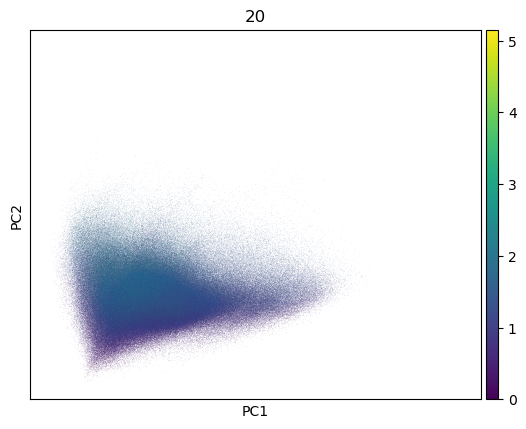

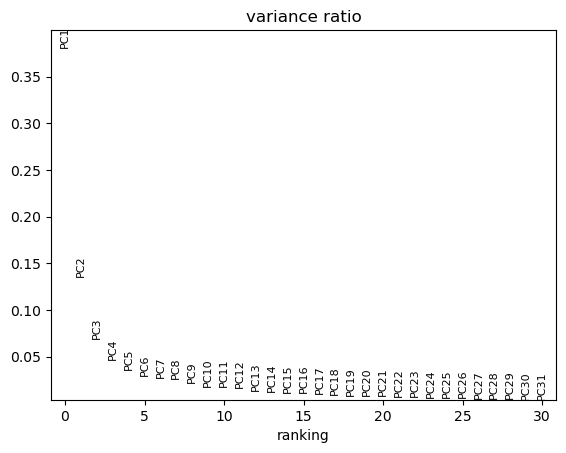

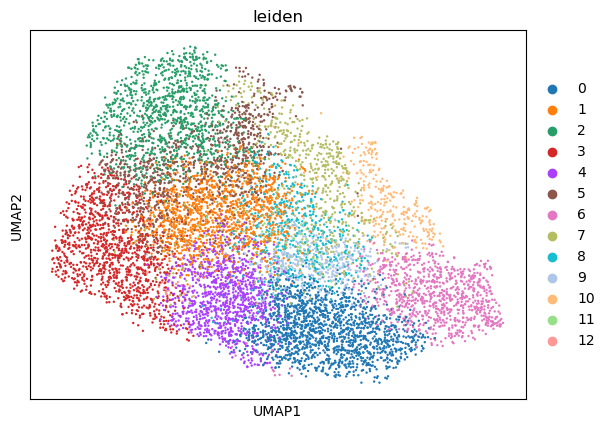

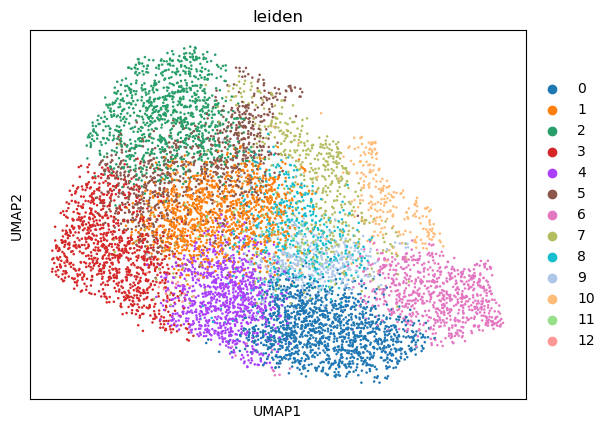

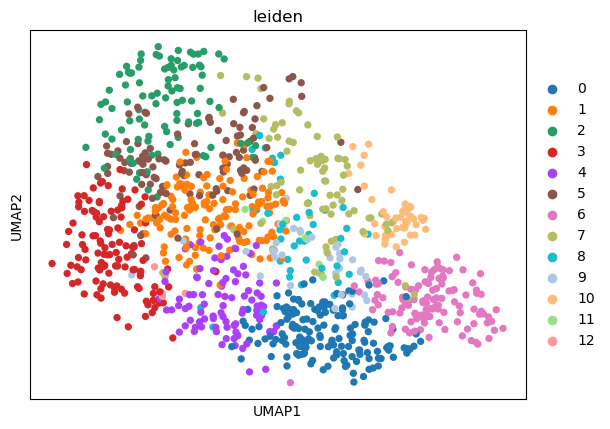

8925
(8925, 2)


In [155]:
x = np.concatenate((instance.train_all_original, instance.validation_all_original), axis=0)
print(instance.instance)
a = ad.AnnData(x)
sc.tl.pca(a, svd_solver='arpack')
sc.pl.pca(a, color='20')
sc.pl.pca_variance_ratio(a)
b = a[random_choice, :].copy()

sc.pp.neighbors(b)
sc.tl.leiden(b)
sc.tl.umap(b)
sc.pl.umap(b, color='leiden')
sc.pl.umap(b[mm, :], color='leiden')
sc.pl.umap(b[nn, :], color='leiden')

u = b.obsm['X_umap'][mm]

print(len(p))
print(u.shape)

random_colors = np.random.random((10000, 3))
c = random_colors[p, :]

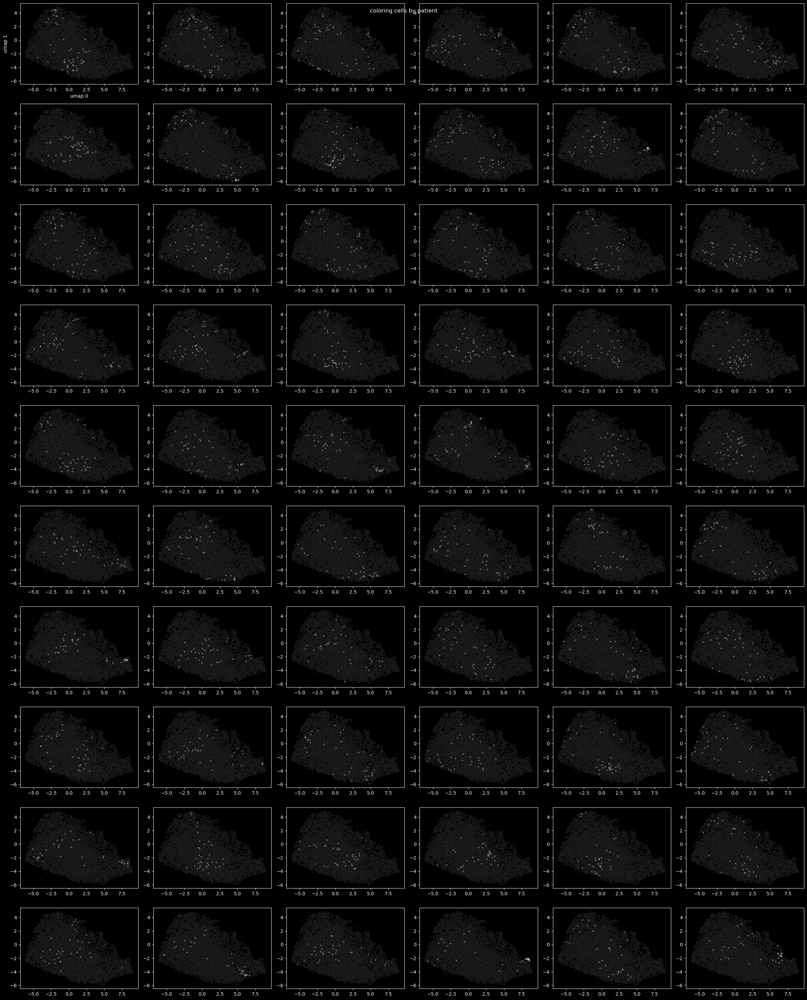

In [156]:
plt.style.use('dark_background')

n = 60
c = 6
r = math.ceil(n / c)

fig, axes = plt.subplots(r, c, figsize=(c * 4, r * 3))
axes = axes.flatten()

unique, counts = np.unique(p, return_counts=True)
uu, cc = map(list, zip(*sorted(zip(unique, counts), key=lambda x: -x[1])))
top = uu[:n]

b = True
for i, t in enumerate(top):
    ax = axes[i]
    if b:
        b = False
        ax.set_xlabel('umap 0')
        ax.set_ylabel('umap 1')
    one_color = np.array([0.1, 0.1, 0.1, 1.]).reshape((1, 4))
    colors = np.tile(one_color, (len(u), 1))
    ax.scatter(u[:, 0], u[:, 1], c=colors, s=2)
    a = np.where(p == t)[0]
    the_color = np.array([1., 1., 1.])
#     the_color = random_colors[t, :]
    colors[a, :3] = the_color
    colors[a, 3] = [0.3]
    ax.scatter(u[a, 0], u[a, 1], c=colors[a, :], s=4)
plt.suptitle('coloring cells by patient')
plt.tight_layout()
plt.style.use('default')
plt.show(plt)

# Plotting log var

vae_transformed_mean_dataset


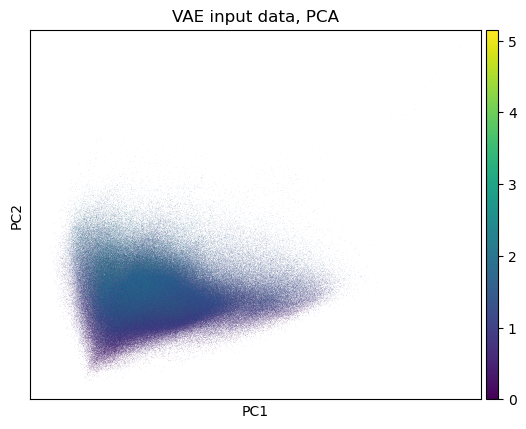

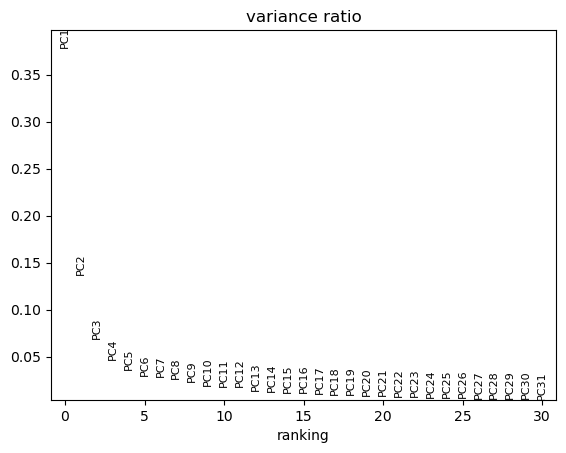

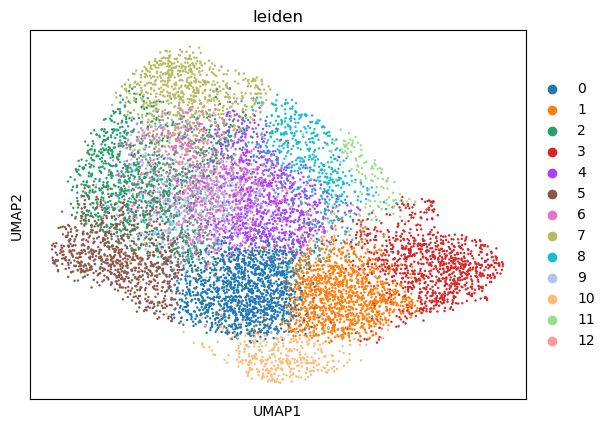

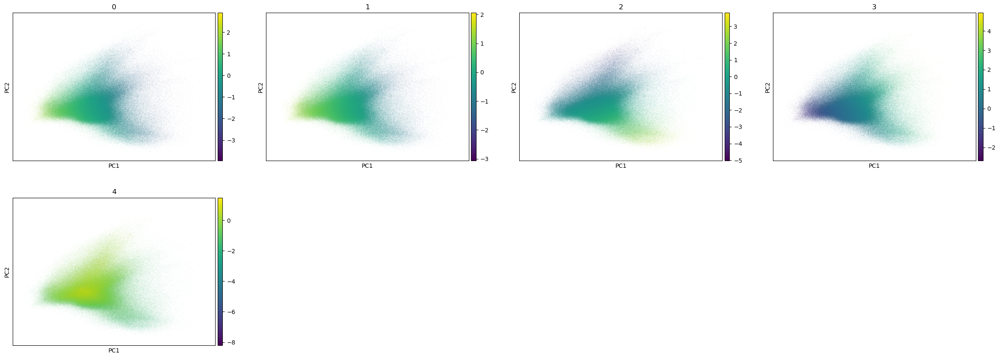

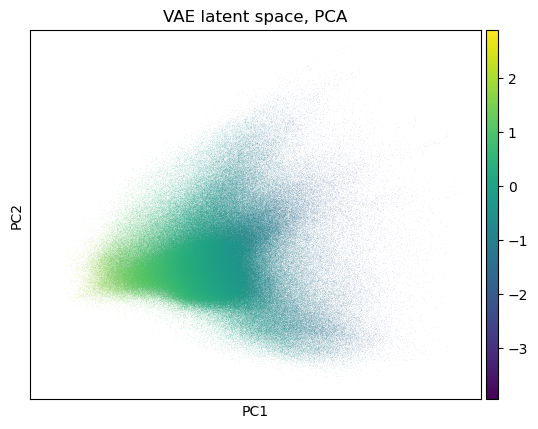

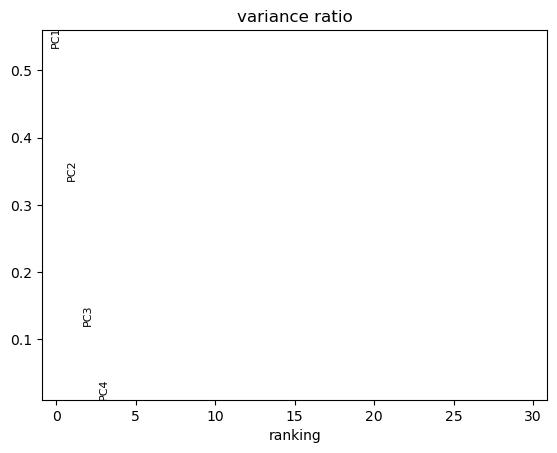

{'params': {'zero_center': True, 'use_highly_variable': False}, 'variance': array([1.5715738 , 0.99103835, 0.35287942, 0.03093377]), 'variance_ratio': array([0.53333943, 0.33632517, 0.11975544, 0.01049788])}


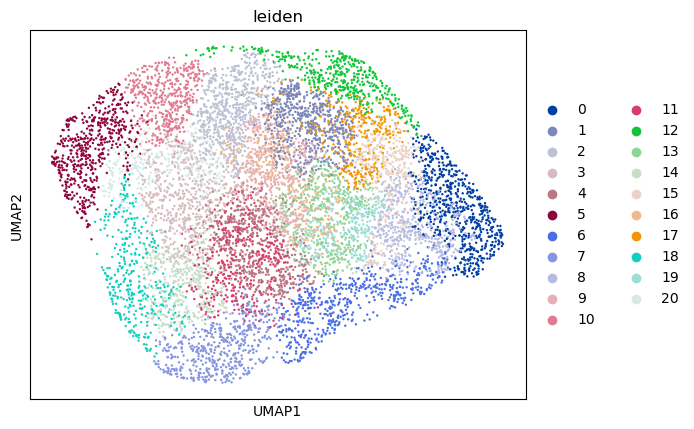

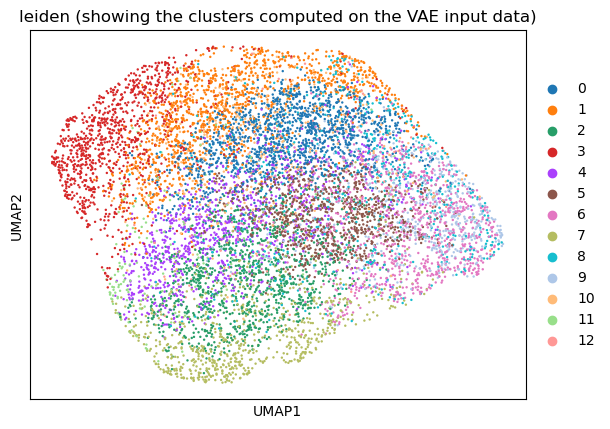

AnnData object with n_obs × n_vars = 762354 × 39
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
AnnData object with n_obs × n_vars = 762354 × 5
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
AnnData object with n_obs × n_vars = 10000 × 39
    obs: 'leiden'
    uns: 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
AnnData object with n_obs × n_vars = 10000 × 5
    obs: 'leiden', 'leiden_b0'
    uns: 'pca', 'neighbors', 'leiden', 'umap', 'leiden_colors', 'leiden_b0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'


In [184]:
instance = instances[4]

import numpy as np
random_choice = np.random.choice(len(instance.all_original), 10000, replace=False)

print(instance.instance)
a0 = ad.AnnData(instance.all_original)
a1 = ad.AnnData(instance.all_mu)
a2 = ad.AnnData(instance.all_log_var)

sc.tl.pca(a0, svd_solver='arpack')

sc.pl.pca(a0, color='20', title='VAE input data, PCA')
sc.pl.pca_variance_ratio(a0)

# sc.pl.pca_variance_ratio(a0, log=True)
b0 = a0[random_choice, :].copy()
sc.pp.neighbors(b0)
sc.tl.leiden(b0)
sc.tl.umap(b0)
sc.pl.umap(b0, color='leiden')

sc.tl.pca(a1, svd_solver='arpack')

sc.pl.pca(a1, color=['0', '1', '2', '3', '4'])
sc.pl.pca(a1, color='0', title='VAE latent space, PCA')
sc.pl.pca_variance_ratio(a1)

print(a1.uns['pca'])
a1

b1 = a1[random_choice, :].copy()
sc.pp.neighbors(b1)
sc.tl.leiden(b1)
sc.tl.umap(b1)
sc.pl.umap(b1, color='leiden')

b1.obs['leiden_b0'] = b0.obs['leiden']
sc.pl.umap(b1, color='leiden_b0', title='leiden (showing the clusters computed on the VAE input data)')

print(a0)
print(a1)
print(b0)
print(b1)

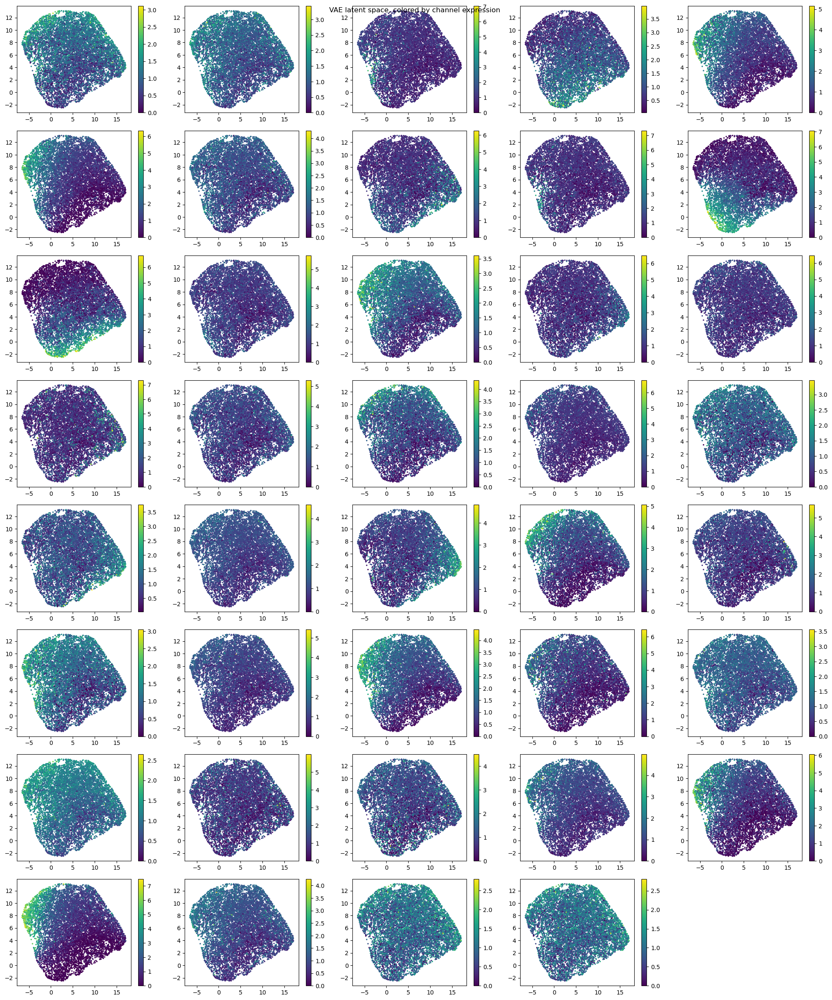

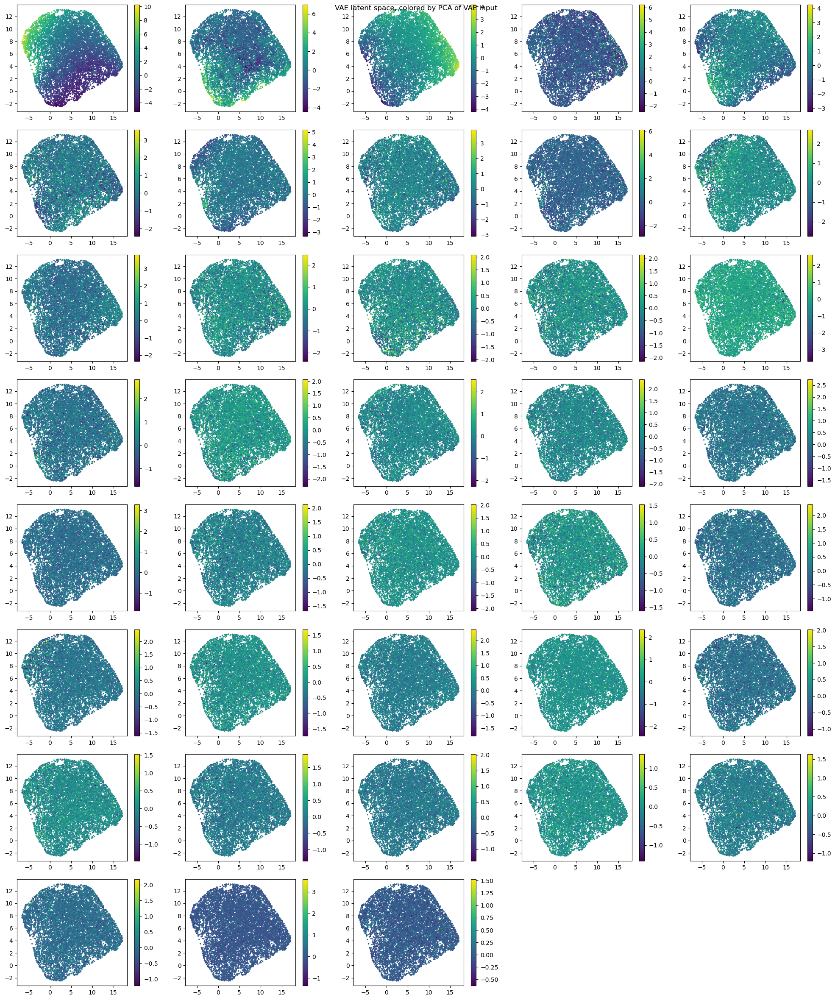

In [296]:
u = b1.obsm['X_umap']

plt.figure(figsize=(5 * 4, 8 * 3))
plt.suptitle('VAE latent space, colored by channel expression')
for i in range(39):
    plt.subplot(8, 5, i + 1)
    plt.scatter(u[:, 0], u[:, 1], c=b0.X[:, i], s=2)
    plt.colorbar()
plt.tight_layout()
plt.show()

plt.figure(figsize=(5 * 4, 8 * 3))
plt.suptitle('VAE latent space, colored by PCA of VAE input')
for i in range(38):
    plt.subplot(8, 5, i + 1)
    plt.scatter(u[:, 0], u[:, 1], c=b0.obsm['X_pca'][:, i], s=2)
    plt.colorbar()
plt.tight_layout()
plt.show()

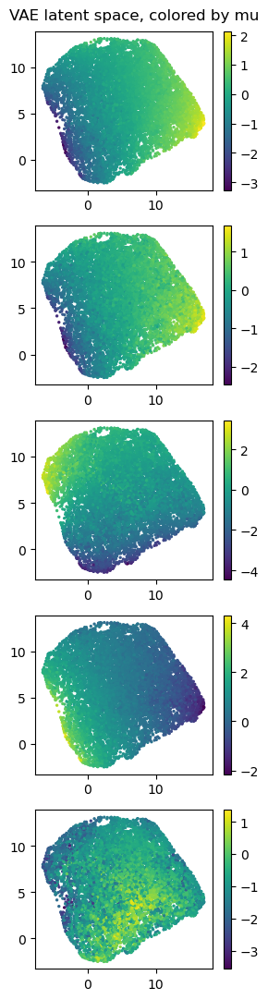

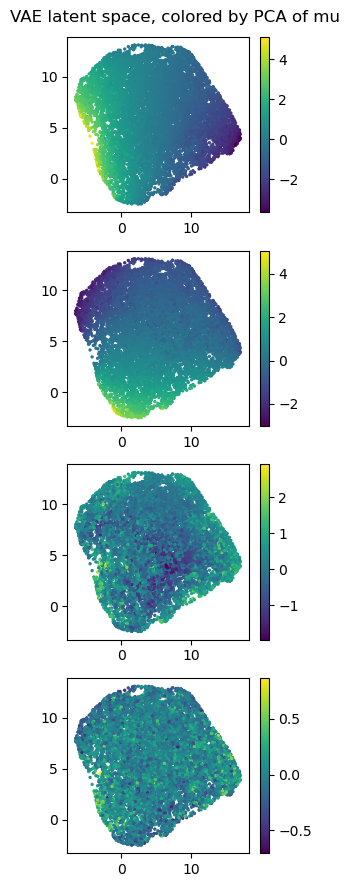

In [302]:
u = b1.obsm['X_umap']
plt.figure(figsize=(3, 11))
plt.suptitle('VAE latent space, colored by mu')
for i in range(5):
    plt.subplot(5, 1, i + 1)
    plt.scatter(u[:, 0], u[:, 1], c=b1.X[:, i], s=2)
    plt.colorbar()
plt.tight_layout()
plt.show()

plt.figure(figsize=(3, 9))
plt.suptitle('VAE latent space, colored by PCA of mu')
for i in range(4):
    plt.subplot(4, 1, i + 1)
    plt.scatter(u[:, 0], u[:, 1], c=b1.obsm['X_pca'][:, i], s=2)
    plt.colorbar()
plt.tight_layout()
plt.show()

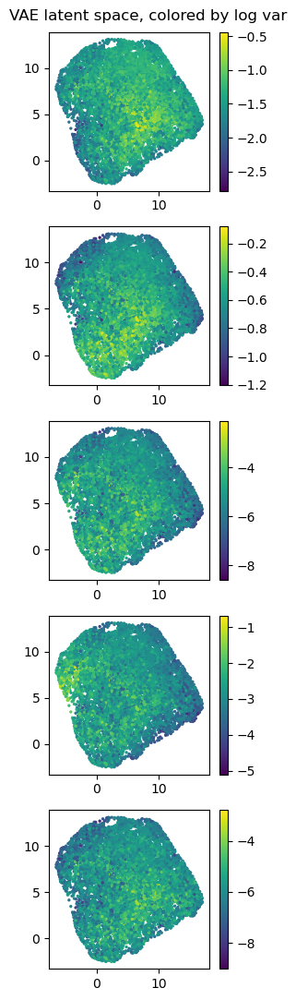

In [297]:
b2 = a2[random_choice, :].copy().X
u = b1.obsm['X_umap']
plt.figure(figsize=(3, 11))
plt.suptitle('VAE latent space, colored by log var')
for i in range(5):
    plt.subplot(5, 1, i + 1)
    plt.scatter(u[:, 0], u[:, 1], c=b2[:, i], s=2)
    plt.colorbar()
plt.tight_layout()
plt.show()

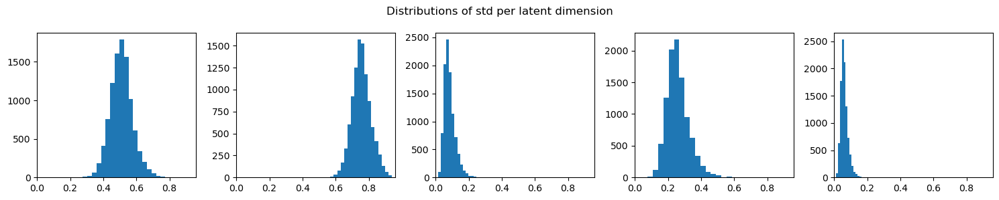

In [304]:
b2 = np.sqrt(np.exp(a2[random_choice, :].copy().X))
m = np.max(b2)

plt.figure(figsize=(15, 3))
plt.suptitle('Distributions of std per latent dimension')
for i in range(5):
    plt.subplot(1, 5, i + 1)
    plt.hist(b2[:, i], bins=20)
    plt.xlim([0, m])
plt.tight_layout()
plt.show()

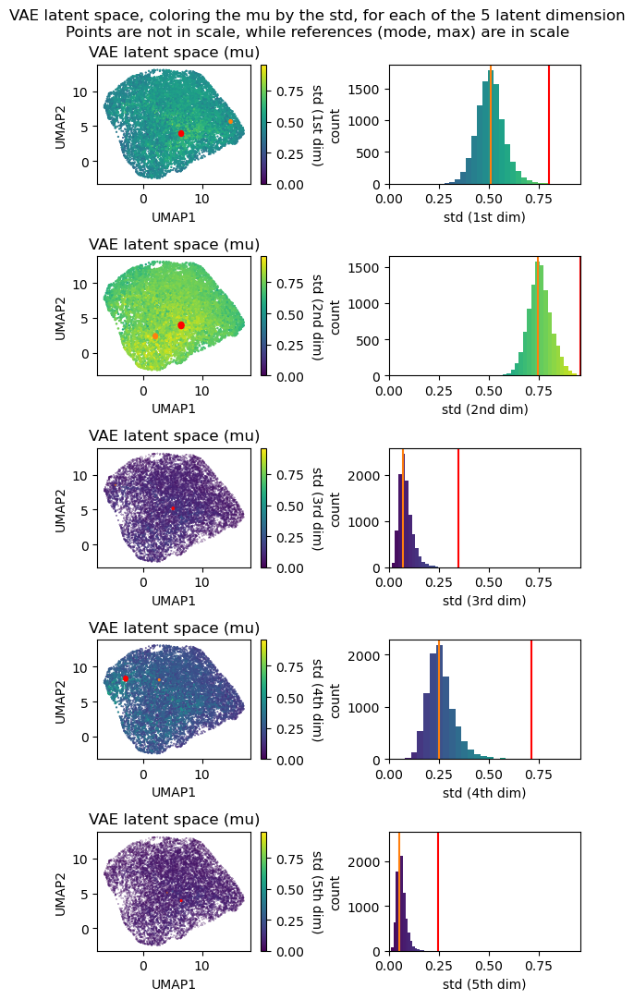

In [305]:
# from matplotlib.collections import PatchCollection
# from matplotlib.patches import Circle

u = b1.obsm['X_umap']
plt.figure(figsize=(6, 11))
plt.suptitle('VAE latent space, coloring the mu by the std, for each of the 5 latent dimension\nPoints are not in scale, while references (mode, max) are in scale')
cmap = plt.cm.viridis
for i in range(5):
    plt.subplot(5, 2, 2 * i + 1)
    plt.scatter(u[:, 0], u[:, 1], c=b2[:, i], s=b2[:, i], cmap=cmap)
    plt.clim([0, m])
    cbar = plt.colorbar()
    cbar.ax.get_yaxis().labelpad = 15
    cbar.ax.set_ylabel(f'std ({humanize.ordinal(i + 1)} dim)', rotation=270)
    plt.xlabel('UMAP1')
    plt.ylabel('UMAP2')
    import humanize
    plt.title(f'VAE latent space (mu)')
    
#    circles = [plt.Circle((xi, yi), radius=0.5, linewidth=0) for xi, yi in zip(u[:, 0], u[:, 1])]
#    c = matplotlib.collections.PatchCollection(circles)
    ax = plt.gca()
#    ax.add_collection(c)
    ii = np.argmax(b2[:, i])
    circle = plt.Circle((u[ii, 0], u[ii, 1]), b2[ii, i] / 2, color='r')
    ax.add_artist(circle)
    
    bins = 20
    hist, bin_edges = np.histogram(b2[:, i], bins=bins)
    jj = np.argmax(hist)
    mode = 0.5 * (bin_edges[jj] + bin_edges[jj + 1])
    jjj = np.argmin(np.abs(b2[:, i] - mode))
    circle = plt.Circle((u[jjj, 0], u[jjj, 1]), b2[jjj, i] / 2, color='tab:orange')
    ax.add_artist(circle)

#    ii = np.argmax(b2[:, i])
#    plt.scatter(u[ii, 0], u[ii, 1], c='r', s=b2[ii, i])
    plt.subplot(5, 2, 2 * i + 2)
    plt.xlabel(f'std ({humanize.ordinal(i + 1)} dim)')
    plt.ylabel('count')
    n, bins, patches = plt.hist(b2[:, i], bins=bins)
    bin_centers = 0.5 * (bins[:-1] + bins[1:])
    col = bin_centers - 0
#    col /= max(col)

    for c, p in zip(col, patches):
        plt.setp(p, 'facecolor', cmap(c))
    plt.xlim([0, m])
    plt.axvline(x=b2[ii, i], c='r')
    plt.axvline(x=mode, c='tab:orange')
    
plt.tight_layout()
plt.show()

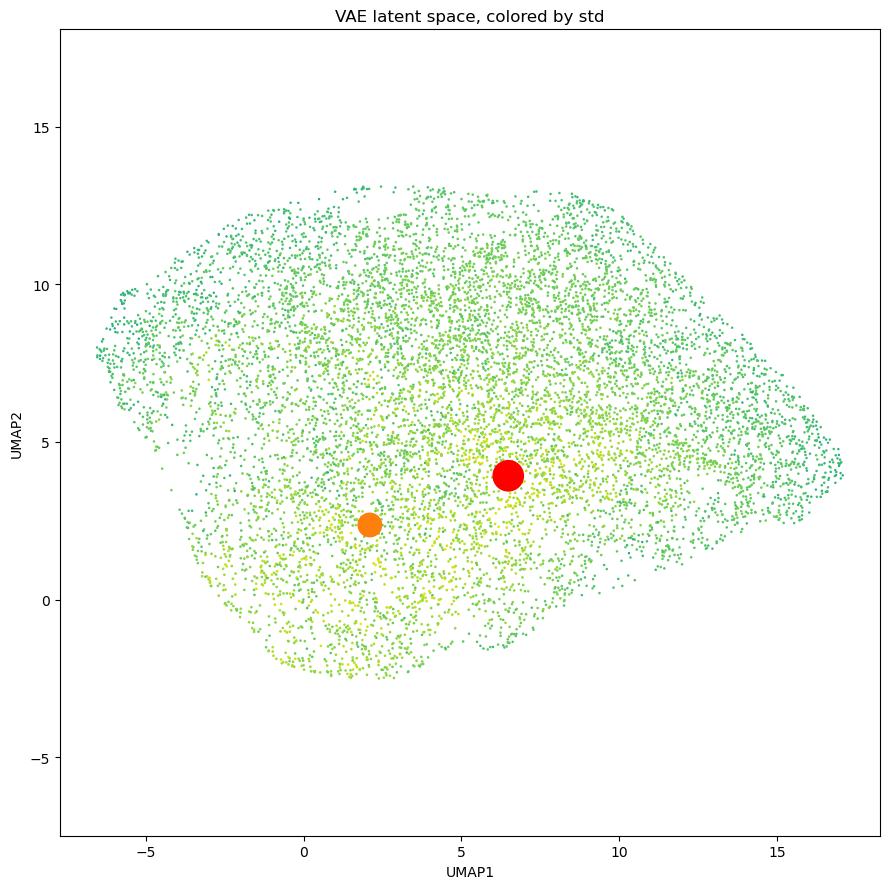

In [306]:
plt.figure(figsize=(9, 9))
plt.title('VAE latent space, colored by std')
i = 1
plt.scatter(u[:, 0], u[:, 1], c=b2[:, i], s=b2[:, i])
plt.clim([0, m])
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
# cbar = plt.colorbar(orientation='horizontal', pad=0.075)
# cbar.ax.get_xaxis().labelpad = 10
# cbar.ax.set_xlabel(f'std ({humanize.ordinal(i + 1)} dim)')

ii = np.argmax(b2[:, i])
circle = plt.Circle((u[ii, 0], u[ii, 1]), b2[ii, i] / 2, color='r')
ax = plt.gca()
ax.add_artist(circle)

bins = 20
hist, bin_edges = np.histogram(b2[:, i], bins=bins)
jj = np.argmax(hist)
mode = 0.5 * (bin_edges[jj] + bin_edges[jj + 1])
jjj = np.argmin(np.abs(b2[:, i] - mode))
circle = plt.Circle((u[jjj, 0], u[jjj, 1]), b2[jjj, i] / 2, color='tab:orange')
ax.add_artist(circle)

plt.axis('equal')
plt.tight_layout()
plt.show()

3492

In [181]:
print(a.shape, b.shape)
print(a)
print(b)
print(a.obsm['X_pca'].shape)

(854652, 39) (10000, 39)
AnnData object with n_obs × n_vars = 854652 × 39
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
AnnData object with n_obs × n_vars = 10000 × 39
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
(854652, 38)


(854652, 39)

In [182]:
sc.pl.umap(b_mu[mm], color=b[:, 0])


KeyboardInterrupt

